In [1]:
# Libraries for working with multidimensional arrays
import numpy as np
import xarray as xr
import pandas as pd

# Libraries for plotting and visualising data
import matplotlib.path as mpath
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import cartopy.feature as cfeature


import os
import sys
import json
from zipfile import ZipFile
import time
import base64
from IPython.core.display import HTML

import requests
import warnings
warnings.filterwarnings('ignore')

In [2]:
pip install -U hda

Note: you may need to restart the kernel to use updated packages.


In [3]:
import requests
import tqdm
from hda import Client, Configuration

In [4]:
dataset_id = "EO:ECMWF:DAT:REANALYSIS_ERA5_SINGLE_LEVELS_MONTHLY_MEANS"

In [5]:
{
  "dataset_id": "EO:ECMWF:DAT:REANALYSIS_ERA5_SINGLE_LEVELS_MONTHLY_MEANS",
  "itemsPerPage": 200,
  "startIndex": 0
}

{'dataset_id': 'EO:ECMWF:DAT:REANALYSIS_ERA5_SINGLE_LEVELS_MONTHLY_MEANS',
 'itemsPerPage': 200,
 'startIndex': 0}

# Total Precipitation and Snowfall

In [6]:
data = {
  "dataset_id": "EO:ECMWF:DAT:REANALYSIS_ERA5_SINGLE_LEVELS_MONTHLY_MEANS",
  "product_type": [
    "monthly_averaged_reanalysis"
  ],
  "variable": [
    "Total Precipitation" , "Snowfall" , "2m_temperature"
  ],
  "year": [
    "1979",
    "1980",
    "1981",
    "1982",
    "1983",
    "1984",
    "1985",
    "1986",
    "1987",
    "1988",
    "1989",
    "1990",
    "1991",
    "1992",
    "1993",
    "1994",
    "1995",
    "1996",
    "1997",
    "1998",
    "1999",
    "2000",
    "2001",
    "2002",
    "2003",
    "2004",
    "2005",
    "2006",
    "2007",
    "2008",
    "2009",
    "2010",
    "2011",
    "2012",
    "2013",
    "2014",
    "2015",
    "2016",
    "2017",
    "2018",
    "2019",
    "2020",
    "2021",
    "2022",
    "2023"
      ],
  
  "month": [
    "01",
    "02",
    "03",
    "04",
    "05",
    "06",
    "07",
    "08",
    "09",
    "10", 
    "11",
    "12"],
  "time": [
    "00:00",
    "06:00",
    "12:00",
    "18:00"
  ],
  "bbox": [
    -180,
    90,
    180,
    60
  ],
  "format": "netcdf",
  "itemsPerPage": 200,
  "startIndex": 0
}

In [7]:
#def load_data():
#conf = Configuration(user = "zcasty", password = "green1234Zaria")
    #hda_client = Client(config = conf)
    #c = Client(debug=True)
#c = Client(config=conf, max_workers=12)
#matches = c.search(data)
#print(matches)
#matches.download()

In [8]:
# get filename of latest .nc downloaded file 
files = [file for file in os.listdir(".") if (file.lower().endswith('.nc'))]
list_nc_file = []

for file in sorted(files,key=os.path.getmtime, reverse=True):
    list_nc_file.append(file)
    
print(f'Selected netCDF file: {list_nc_file[0]}')  

Selected netCDF file: reanalysis-era5-single-levels-monthly-means-27135186e2ed04fa1cdef664179a1156.nc


In [9]:
# Define the path to your NetCDF file
file_path = "reanalysis-era5-single-levels-monthly-means-d891cf072f02d7845c0ec8350ca6478a.nc"

# Load NetCDF file
ds = xr.open_dataset(file_path)

# Print dataset to understand its structure
print(ds)

# Extract the Total Precipitation and Snowfall variables
tp = ds['tp']  # total precipitation variable
sf = ds['sf']  # snowfall variable

<xarray.Dataset>
Dimensions:    (date: 540, latitude: 121, longitude: 1440)
Coordinates:
    number     int64 ...
  * date       (date) int64 19790101 19790201 19790301 ... 20231101 20231201
  * latitude   (latitude) float64 90.0 89.75 89.5 89.25 ... 60.5 60.25 60.0
  * longitude  (longitude) float64 -180.0 -179.8 -179.5 ... 179.2 179.5 179.8
    expver     (date) object ...
Data variables:
    tp         (date, latitude, longitude) float32 ...
    sf         (date, latitude, longitude) float32 ...
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts
    history:                 2024-10-08T17:54 GRIB to CDM+CF via cfgrib-0.9.1...


In [12]:
tp

<xarray.DataArray 'tp' (date: 540, latitude: 121, longitude: 1440)>
[94089600 values with dtype=float32]
Coordinates:
    number     int64 ...
  * date       (date) int64 19790101 19790201 19790301 ... 20231101 20231201
  * latitude   (latitude) float64 90.0 89.75 89.5 89.25 ... 60.5 60.25 60.0
  * longitude  (longitude) float64 -180.0 -179.8 -179.5 ... 179.2 179.5 179.8
    expver     (date) object ...
Attributes: (12/32)
    GRIB_paramId:                             228
    GRIB_dataType:                            fc
    GRIB_numberOfPoints:                      174240
    GRIB_typeOfLevel:                         surface
    GRIB_stepUnits:                           1
    GRIB_stepType:                            avgad
    ...                                       ...
    GRIB_totalNumber:                         0
    GRIB_units:                               m
    long_name:                                Total precipitation
    units:                                    m
    standard_name:                            unknown
    GRIB_surface:                             0.0

In [13]:
sf

<xarray.DataArray 'sf' (date: 540, latitude: 121, longitude: 1440)>
[94089600 values with dtype=float32]
Coordinates:
    number     int64 ...
  * date       (date) int64 19790101 19790201 19790301 ... 20231101 20231201
  * latitude   (latitude) float64 90.0 89.75 89.5 89.25 ... 60.5 60.25 60.0
  * longitude  (longitude) float64 -180.0 -179.8 -179.5 ... 179.2 179.5 179.8
    expver     (date) object ...
Attributes: (12/32)
    GRIB_paramId:                             144
    GRIB_dataType:                            fc
    GRIB_numberOfPoints:                      174240
    GRIB_typeOfLevel:                         surface
    GRIB_stepUnits:                           1
    GRIB_stepType:                            avgad
    ...                                       ...
    GRIB_totalNumber:                         0
    GRIB_units:                               m of water equivalent
    long_name:                                Snowfall
    units:                                    m of water equivalent
    standard_name:                            lwe_thickness_of_snowfall_amount
    GRIB_surface:                             0.0

# Creation of Liquid Precipitation

In [14]:
data = {
  "dataset_id": "EO:ECMWF:DAT:REANALYSIS_ERA5_SINGLE_LEVELS_MONTHLY_MEANS",
  "product_type": [
    "monthly_averaged_reanalysis"
  ],
  "variable": [
    "large_scale_precipitation", "convective_precipitation"
  ],
  "year": [
    "1979",
    "1980",
    "1981",
    "1982",
    "1983",
    "1984",
    "1985",
    "1986",
    "1987",
    "1988",
    "1989",
    "1990",
    "1991",
    "1992",
    "1993",
    "1994",
    "1995",
    "1996",
    "1997",
    "1998",
    "1999",
    "2000",
    "2001",
    "2002",
    "2003",
    "2004",
    "2005",
    "2006",
    "2007",
    "2008",
    "2009",
    "2010",
    "2011",
    "2012",
    "2013",
    "2014",
    "2015",
    "2016",
    "2017",
    "2018",
    "2019",
    "2020",
    "2021",
    "2022",
    "2023"
      ],
  
  "month": [
    "01",
    "02",
    "03",
    "04",
    "05",
    "06",
    "07",
    "08",
    "09",
    "10", 
    "11",
    "12"],
  "time": [
    "00:00",
    "06:00",
    "12:00",
    "18:00"
  ],
  "bbox": [
    -180,
    90,
    180,
    60
  ],
  "format": "netcdf",
  "itemsPerPage": 200,
  "startIndex": 0
}

In [15]:
#def load_data():
#conf = Configuration(user = "zcasty", password = "green1234Zaria")
    #hda_client = Client(config = conf)
    #c = Client(debug=True)
#c = Client(config=conf, max_workers=12)
#matches = c.search(data)
#print(matches)
#matches.download()

In [16]:
# Calculate liquid precipitation
liquid_precip = tp - sf

# Print the result to verify
print(liquid_precip)

<xarray.DataArray (date: 540, latitude: 121, longitude: 1440)>
array([[[ 1.4305115e-06,  1.4305115e-06,  1.4305115e-06, ...,
          1.4305115e-06,  1.4305115e-06,  1.4305115e-06],
        [-1.4305115e-06, -9.5367432e-07, -9.5367432e-07, ...,
         -1.4305115e-06, -1.4305115e-06, -1.4305115e-06],
        [ 4.7683716e-07,  9.5367432e-07, -9.5367432e-07, ...,
          4.7683716e-07,  4.7683716e-07,  4.7683716e-07],
        ...,
        [ 5.5074692e-04,  5.5980682e-04,  5.6600571e-04, ...,
          5.1784515e-04,  5.2976608e-04,  5.3930283e-04],
        [ 5.7506561e-04,  5.8412552e-04,  5.8126450e-04, ...,
          5.4407120e-04,  5.5360794e-04,  5.6457520e-04],
        [ 5.9223175e-04,  5.9413910e-04,  6.0224533e-04, ...,
          5.8269501e-04,  5.8841705e-04,  5.9175491e-04]],

       [[ 9.5367432e-07,  9.5367432e-07,  9.5367432e-07, ...,
          9.5367432e-07,  9.5367432e-07,  9.5367432e-07],
        [-4.7683716e-07, -4.7683716e-07, -4.7683716e-07, ...,
         -4.7683716e

## The mean data (0-2000mm)

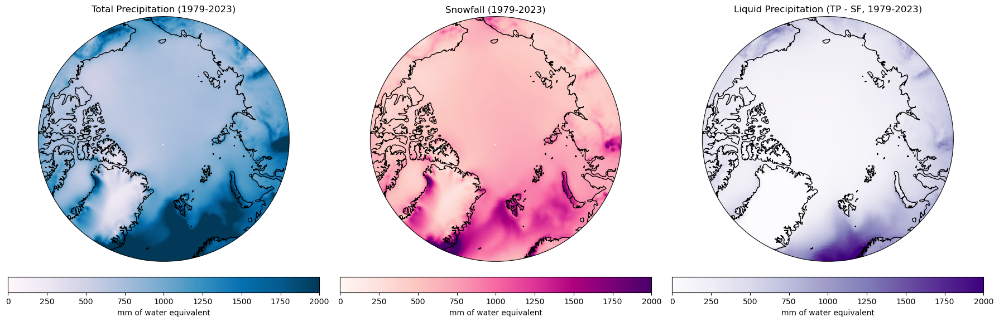

In [15]:
# North Polar Orthographic projection
def plot_map(ax, data, title, vmin=0, vmax=2000, cmap='PuBu'):
    ax.set_global()
    ax.coastlines()
    
    # Circular boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    
    # Set map extent
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Multiply the data by 1000 to convert from meters to millimeters
    data_mm = data * 1000 * 1000

    # Plot data
    pp = ax.pcolormesh(data_mm.longitude, data_mm.latitude, data_mm.mean(dim='date'),
                       cmap=cmap, transform=ccrs.PlateCarree(), vmin=vmin, vmax=vmax)

    # Add colorbar
    cbar = plt.colorbar(pp, ax=ax, orientation='horizontal', pad=0.05)
    cbar.set_label('mm of water equivalent')

    # Add title
    ax.set_title(title)

# Create figure and subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Plot Total Precipitation
plot_map(axes[0], tp, 'Total Precipitation (1979-2023)', vmin=0, vmax=2000)

# Plot Snowfall
plot_map(axes[1], sf, 'Snowfall (1979-2023)', vmin=0, vmax=2000, cmap='RdPu')

# Plot Calculated Liquid Precipitation (TP - SF)
plot_map(axes[2], liquid_precip, 'Liquid Precipitation (TP - SF, 1979-2023)', vmin=0, vmax=2000, cmap='Purples')

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()
#plt.savefig('MeanArcticTP_S_LP.png', dpi=300)  # Save the figure

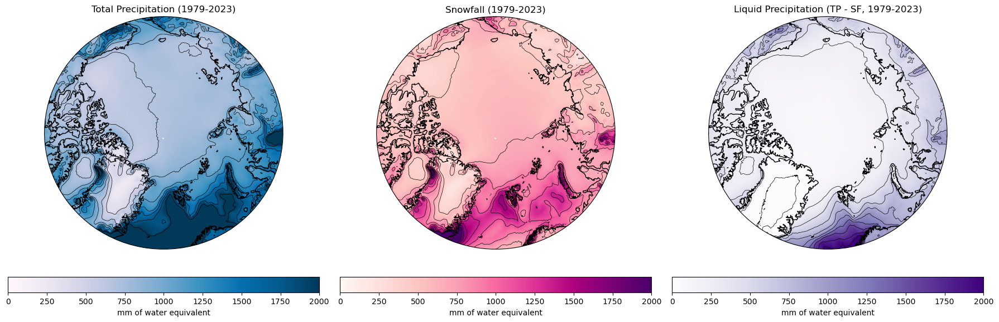

<Figure size 640x480 with 0 Axes>

In [16]:
# North Polar Orthographic projection with contour lines
def plot_map(ax, data, title, vmin=0, vmax=2000, cmap='PuBu', contour_levels=10):
    ax.set_global()
    ax.coastlines()
    
    # Circular boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    
    # Set map extent
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Multiply the data by 1000 to convert from meters to millimeters
    data_mm = data * 1000 * 1000

    # Plot the data
    pp = ax.pcolormesh(data_mm.longitude, data_mm.latitude, data_mm.mean(dim='date'),
                       cmap=cmap, transform=ccrs.PlateCarree(), vmin=vmin, vmax=vmax)

    # Add contour lines on top of the plot
    contours = ax.contour(data_mm.longitude, data_mm.latitude, data_mm.mean(dim='date'), 
                          levels=contour_levels, colors='black', linewidths=0.5, transform=ccrs.PlateCarree())

    # Add colorbar
    cbar = plt.colorbar(pp, ax=ax, orientation='horizontal', pad=0.09)
    cbar.set_label('mm of water equivalent')

    # Add title
    ax.set_title(title)

# Create figure and subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Plot Total Precipitation with contours
plot_map(axes[0], tp, 'Total Precipitation (1979-2023)', vmin=0, vmax=2000, contour_levels=np.linspace(0, 2000, 10))

# Plot Snowfall with contours
plot_map(axes[1], sf, 'Snowfall (1979-2023)', vmin=0, vmax=2000, cmap='RdPu', contour_levels=np.linspace(0, 2000, 10))

# Plot Calculated Liquid Precipitation (TP - SF) with contours
plot_map(axes[2], liquid_precip, 'Liquid Precipitation (TP - SF, 1979-2023)', vmin=0, vmax=2000, cmap='Purples', contour_levels=np.linspace(0, 2000, 10))

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()
plt.savefig('MeanArcticTP_S_LP.png', dpi=300, bbox_inches='tight')  # Save the figure


## The annual totals data (0-1000mm)

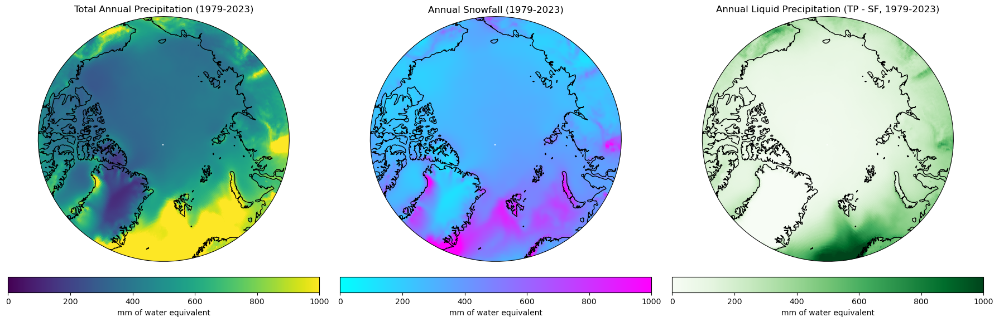

In [17]:
# North Polar Orthographic projection
def plot_map(ax, data, title, vmin=0, vmax=1000, cmap='viridis'):
    ax.set_global()
    ax.coastlines()
    
    # Circular boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    
    # Set map extent
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Multiply the data by 1000 to convert from meters to millimeters
    data_mm = data * 1000

    # Sum over the 'date' dimension to get annual totals
    data_annual_total = data_mm.sum(dim='date')

    # Plot data
    pp = ax.pcolormesh(data_annual_total.longitude, data_annual_total.latitude, 
                       data_annual_total, cmap=cmap, transform=ccrs.PlateCarree(), vmin=vmin, vmax=vmax)

    # Add colorbar
    cbar = plt.colorbar(pp, ax=ax, orientation='horizontal', pad=0.05)
    cbar.set_label('mm of water equivalent')

    # Add title
    ax.set_title(title)

# Create figure and subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Plot Total Annual Precipitation
plot_map(axes[0], tp, 'Total Annual Precipitation (1979-2023)', vmin=0, vmax=1000)

# Plot Annual Snowfall
plot_map(axes[1], sf, 'Annual Snowfall (1979-2023)', vmin=0, vmax=1000, cmap='cool')

# Plot Annual Liquid Precipitation (TP - SF)
plot_map(axes[2], liquid_precip, 'Annual Liquid Precipitation (TP - SF, 1979-2023)', vmin=0, vmax=1000, cmap='Greens')

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

## The annual totals data (0-2000mm)

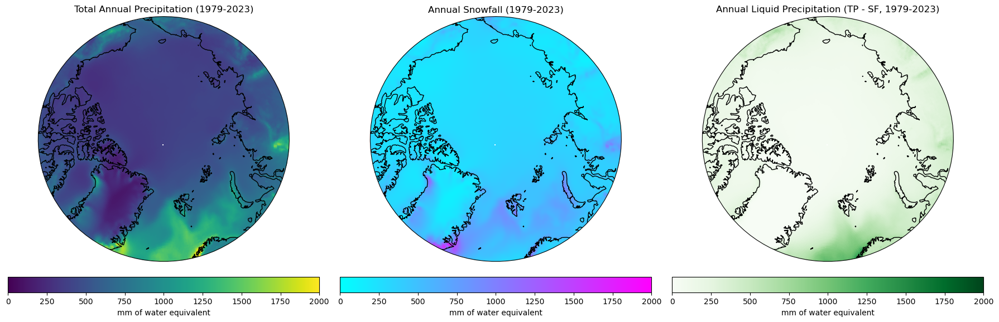

In [18]:
# North Polar Orthographic projection
def plot_map(ax, data, title, vmin=0, vmax=2000, cmap='viridis'):
    ax.set_global()
    ax.coastlines()
    
    # Circular boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    
    # Set map extent
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Multiply the data by 1000 to convert from meters to millimeters
    data_mm = data * 1000

    # Sum over the 'date' dimension to get annual totals
    data_annual_total = data_mm.sum(dim='date')

    # Plot data
    pp = ax.pcolormesh(data_annual_total.longitude, data_annual_total.latitude, 
                       data_annual_total, cmap=cmap, transform=ccrs.PlateCarree(), vmin=vmin, vmax=vmax)

    # Add colorbar
    cbar = plt.colorbar(pp, ax=ax, orientation='horizontal', pad=0.05)
    cbar.set_label('mm of water equivalent')

    # Add title
    ax.set_title(title)

# Create figure and subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Plot Total Annual Precipitation
plot_map(axes[0], tp, 'Total Annual Precipitation (1979-2023)', vmin=0, vmax=2000)

# Plot Annual Snowfall
plot_map(axes[1], sf, 'Annual Snowfall (1979-2023)', vmin=0, vmax=2000, cmap='cool')

# Plot Annual Liquid Precipitation (TP - SF)
plot_map(axes[2], liquid_precip, 'Annual Liquid Precipitation (TP - SF, 1979-2023)', vmin=0, vmax=2000, cmap='Greens')

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

## Summer Month of July (0-100mm)

In [19]:
# Define the plot function with contour lines
def plot_map(ax, data, title, vmin=0, vmax=100, cmap='PuBu', contour_levels=10):
    ax.set_global()
    ax.coastlines()
    
    # Boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    
    # Set map extent 
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # convert from meters to millimeters
    data_mm = data * 1000

    # Plot data for July
    pp = ax.pcolormesh(data_mm.longitude, data_mm.latitude, data_mm, 
                       cmap=cmap, transform=ccrs.PlateCarree(), vmin=vmin, vmax=vmax)
    
    # Add contour lines on top of the plot
    contour_lines = ax.contour(data_mm.longitude, data_mm.latitude, data_mm, 
                               levels=contour_levels, colors='black', linewidths=0.5, transform=ccrs.PlateCarree())
    ax.clabel(contour_lines, inline=True, fontsize=8)  # Add labels to contour lines

    # Add colorbar
    cbar = plt.colorbar(pp, ax=ax, orientation='horizontal', pad=0.05)
    cbar.set_label('mm of water equivalent')

    # Add title
    ax.set_title(title)

# Apply the updated function as before


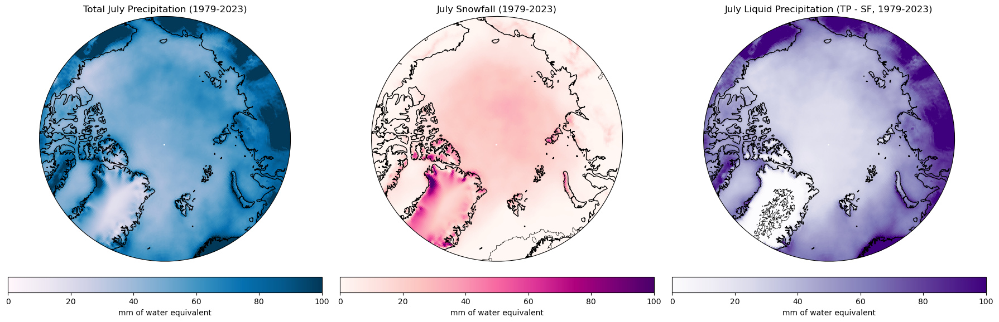

In [20]:
# North Polar Orthographic projection
def plot_map(ax, data, title, vmin=0, vmax=100, cmap='PuBu', contour_levels=10):
    ax.set_global()
    ax.coastlines()
    
    # Boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    
    # Set map extent 
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # convert from meters to millimeters
    data_mm = data * 1000

    # Plot data for July
    pp = ax.pcolormesh(data_mm.longitude, data_mm.latitude, data_mm, 
                       cmap=cmap, transform=ccrs.PlateCarree(), vmin=vmin, vmax=vmax)
    
      # Add contour lines on top of the plot
    contours = ax.contour(data_mm.longitude, data_mm.latitude, data_mm, 
                          levels=contour_levels, colors='black', linewidths=0.5, transform=ccrs.PlateCarree())
    
    # Add colorbar
    cbar = plt.colorbar(pp, ax=ax, orientation='horizontal', pad=0.05)
    cbar.set_label('mm of water equivalent')

    # Add title
    ax.set_title(title)

# Convert 'date' to datetime64 if it's in integer format
tp['date'] = pd.to_datetime(tp['date'].values, format='%Y%m%d')
sf['date'] = pd.to_datetime(sf['date'].values, format='%Y%m%d')
liquid_precip['date'] = pd.to_datetime(liquid_precip['date'].values, format='%Y%m%d')

# Filter data for July 
july_data_tp = tp.sel(date=tp['date'].dt.month == 7)
july_data_sf = sf.sel(date=sf['date'].dt.month == 7)
july_data_liquid_precip = liquid_precip.sel(date=liquid_precip['date'].dt.month == 7)

# Create figure and subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Plot Total Precipitation for July (1979-2023)
plot_map(axes[0], july_data_tp.sum(dim='date'), 'Total July Precipitation (1979-2023)', vmin=0, vmax=100, contour_levels=np.linspace(0, 2000, 10)) 

# Plot Snowfall for July (1979-2023)
plot_map(axes[1], july_data_sf.sum(dim='date'), 'July Snowfall (1979-2023)', vmin=0, vmax=100, cmap='RdPu', contour_levels=np.linspace(0, 2000, 10))

# Plot Liquid Precipitation (TP - SF) for July (1979-2023)
plot_map(axes[2], july_data_liquid_precip.sum(dim='date'), 'July Liquid Precipitation (TP - SF, 1979-2023)', vmin=0, vmax=100, cmap='Purples', contour_levels=np.linspace(0, 2000, 10))

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()
#plt.savefig('JulyArcticTotals.png', dpi=300, bbox_inches='tight')  # Save the figure

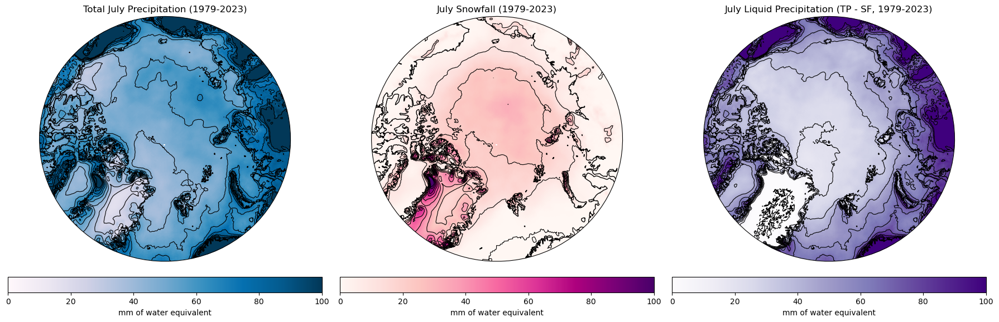

<Figure size 640x480 with 0 Axes>

In [21]:
# North Polar Orthographic projection with contour lines
def plot_map(ax, data, title, vmin=0, vmax=100, cmap='PuBu', contour_levels=10):
    ax.set_global()
    ax.coastlines()
    
    # Boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    
    # Set map extent
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Convert from meters to millimeters
    data_mm = data * 1000

    # Plot data
    pp = ax.pcolormesh(data_mm.longitude, data_mm.latitude, data_mm, 
                       cmap=cmap, transform=ccrs.PlateCarree(), vmin=vmin, vmax=vmax)

    # Add contour lines
    contours = ax.contour(data_mm.longitude, data_mm.latitude, data_mm, 
                          levels=np.linspace(vmin, vmax, contour_levels), colors='black', linewidths=0.8, transform=ccrs.PlateCarree())

    # Add colorbar
    cbar = plt.colorbar(pp, ax=ax, orientation='horizontal', pad=0.05)
    cbar.set_label('mm of water equivalent')

    # Add title
    ax.set_title(title)

# Convert 'date' to datetime64 if it's in integer format
tp['date'] = pd.to_datetime(tp['date'].values, format='%Y%m%d')
sf['date'] = pd.to_datetime(sf['date'].values, format='%Y%m%d')
liquid_precip['date'] = pd.to_datetime(liquid_precip['date'].values, format='%Y%m%d')

# Filter data for July 
july_data_tp = tp.sel(date=tp['date'].dt.month == 7)
july_data_sf = sf.sel(date=sf['date'].dt.month == 7)
july_data_liquid_precip = liquid_precip.sel(date=liquid_precip['date'].dt.month == 7)

# Create figure and subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Plot Total Precipitation for July (1979-2023)
plot_map(axes[0], july_data_tp.sum(dim='date'), 'Total July Precipitation (1979-2023)', vmin=0, vmax=100)

# Plot Snowfall for July (1979-2023)
plot_map(axes[1], july_data_sf.sum(dim='date'), 'July Snowfall (1979-2023)', vmin=0, vmax=100, cmap='RdPu')

# Plot Liquid Precipitation (TP - SF) for July (1979-2023)
plot_map(axes[2], july_data_liquid_precip.sum(dim='date'), 'July Liquid Precipitation (TP - SF, 1979-2023)', vmin=0, vmax=100, cmap='Purples')

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

# Correct figure saving code with tight layout and high dpi
plt.savefig('JulyArcticTotals.png', dpi=300, bbox_inches='tight')  # Save the figure


## Winter Month of January (0-100mm)

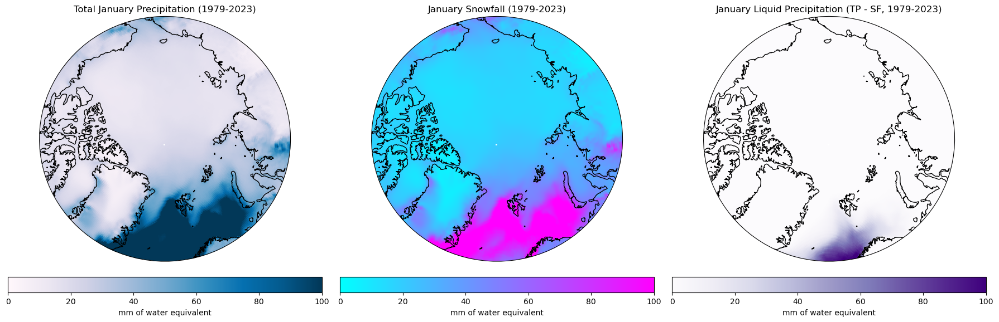

In [22]:
# North Polar Orthographic projection
def plot_map(ax, data, title, vmin=0, vmax=100, cmap='PuBu'):
    ax.set_global()
    ax.coastlines()
    
    # Circular boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    
    # Set map extent 
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # convert from meters to millimeters
    data_mm = data * 1000

    # Plot data for the winter month
    pp = ax.pcolormesh(data_mm.longitude, data_mm.latitude, data_mm, 
                       cmap=cmap, transform=ccrs.PlateCarree(), vmin=vmin, vmax=vmax)

    # Add colorbar
    cbar = plt.colorbar(pp, ax=ax, orientation='horizontal', pad=0.05)
    cbar.set_label('mm of water equivalent')

    # Add title
    ax.set_title(title)

# Convert 'date' to datetime64 if it's in integer format 
tp['date'] = pd.to_datetime(tp['date'].values, format='%Y%m%d')
sf['date'] = pd.to_datetime(sf['date'].values, format='%Y%m%d')
liquid_precip['date'] = pd.to_datetime(liquid_precip['date'].values, format='%Y%m%d')

# Filter data for January (winter month) using .dt.month to access the month component
winter_month = 1  # Set this to 1 for January, or 12 for December, etc.
january_data_tp = tp.sel(date=tp['date'].dt.month == winter_month)
january_data_sf = sf.sel(date=sf['date'].dt.month == winter_month)
january_data_liquid_precip = liquid_precip.sel(date=liquid_precip['date'].dt.month == winter_month)

# Create figure and subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Plot Total Precipitation for January (1979-2023)
plot_map(axes[0], january_data_tp.sum(dim='date'), 'Total January Precipitation (1979-2023)', vmin=0, vmax=100)

# Plot Snowfall for January (1979-2023)
plot_map(axes[1], january_data_sf.sum(dim='date'), 'January Snowfall (1979-2023)', vmin=0, vmax=100, cmap='cool')

# Plot Liquid Precipitation (TP - SF) for January (1979-2023)
plot_map(axes[2], january_data_liquid_precip.sum(dim='date'), 'January Liquid Precipitation (TP - SF, 1979-2023)', vmin=0, vmax=100, cmap='Purples')

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()
#plt.savefig('JanuaryArcticTotals', dpi=300)  # Save the figure

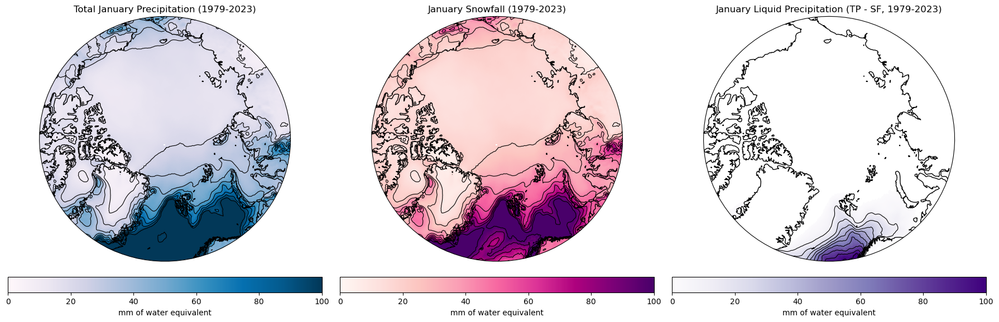

<Figure size 640x480 with 0 Axes>

In [23]:
# North Polar Orthographic projection with contour lines
def plot_map(ax, data, title, vmin=0, vmax=100, cmap='PuBu', contour_levels=10, mask_threshold=0):
    ax.set_global()
    ax.coastlines()
    
    # Circular boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    
    # Set map extent
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Convert from meters to millimeters
    data_mm = data * 1000

    # Mask areas with low values of liquid precipitation to focus on the lower area
    data_mm = data_mm.where(data_mm > mask_threshold)

    # Plot the data
    pp = ax.pcolormesh(data_mm.longitude, data_mm.latitude, data_mm, 
                       cmap=cmap, transform=ccrs.PlateCarree(), vmin=vmin, vmax=vmax)

    # Add contour lines for the visible data only in the lower area
    contours = ax.contour(data_mm.longitude, data_mm.latitude, data_mm, 
                          levels=np.linspace(vmin, vmax, contour_levels), colors='black', linewidths=0.8, transform=ccrs.PlateCarree())

    # Add colorbar
    cbar = plt.colorbar(pp, ax=ax, orientation='horizontal', pad=0.05)
    cbar.set_label('mm of water equivalent')

    # Add title
    ax.set_title(title)

# Convert 'date' to datetime64 if it's in integer format 
tp['date'] = pd.to_datetime(tp['date'].values, format='%Y%m%d')
sf['date'] = pd.to_datetime(sf['date'].values, format='%Y%m%d')
liquid_precip['date'] = pd.to_datetime(liquid_precip['date'].values, format='%Y%m%d')

# Filter data for January (winter month) using .dt.month to access the month component
winter_month = 1  # Set this to 1 for January, or 12 for December, etc.
january_data_tp = tp.sel(date=tp['date'].dt.month == winter_month)
january_data_sf = sf.sel(date=sf['date'].dt.month == winter_month)
january_data_liquid_precip = liquid_precip.sel(date=liquid_precip['date'].dt.month == winter_month)

# Create figure and subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Plot Total Precipitation for January (1979-2023)
plot_map(axes[0], january_data_tp.sum(dim='date'), 'Total January Precipitation (1979-2023)', vmin=0, vmax=100)

# Plot Snowfall for January (1979-2023)
plot_map(axes[1], january_data_sf.sum(dim='date'), 'January Snowfall (1979-2023)', vmin=0, vmax=100, cmap='RdPu')

# Plot Liquid Precipitation (TP - SF) for January (1979-2023), masking low values
plot_map(axes[2], january_data_liquid_precip.sum(dim='date'), 'January Liquid Precipitation (TP - SF, 1979-2023)', 
         vmin=0, vmax=100, cmap='Purples', mask_threshold=1)  # Mask values below 1 mm

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

# Save the figure
plt.savefig('JanuaryArcticTotals_Liquid_Precip_LowerArea.png', dpi=300, bbox_inches='tight')


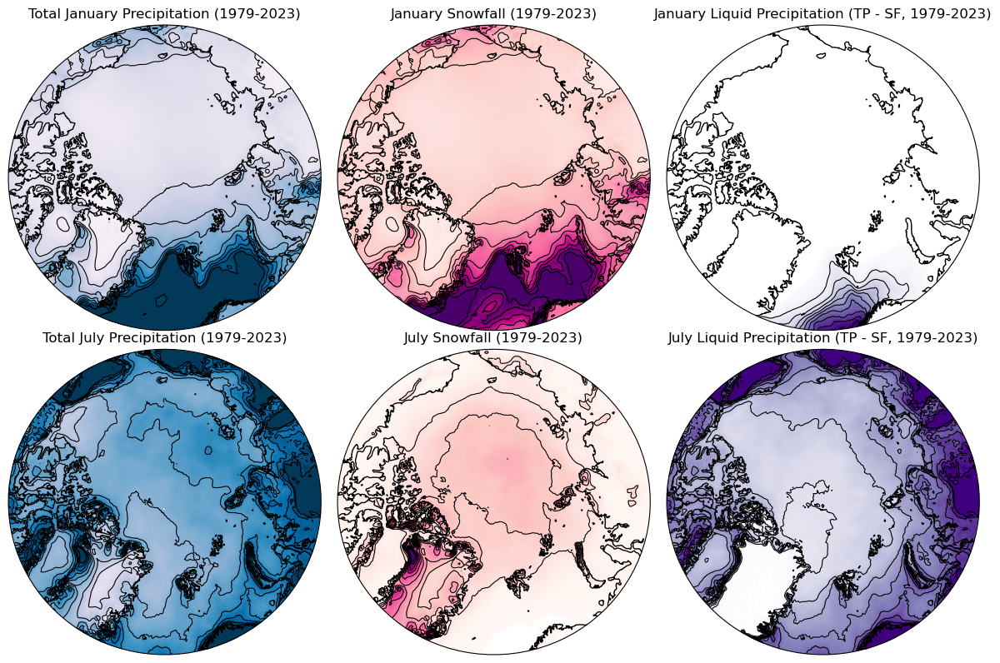

<Figure size 640x480 with 0 Axes>

In [24]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import matplotlib.path as mpath
import pandas as pd

# Define the plot function without contour labels and with adjustable colorbars
def plot_map(ax, data, title, vmin=0, vmax=100, cmap='PuBu', contour_levels=10, mask_threshold=0):
    ax.set_global()
    ax.coastlines()
    
    # Circular boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    
    # Set map extent
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Convert from meters to millimeters
    data_mm = data * 1000

    # Mask areas with low values of liquid precipitation to focus on the lower area
    data_mm = data_mm.where(data_mm > mask_threshold)

    # Plot the data
    pp = ax.pcolormesh(data_mm.longitude, data_mm.latitude, data_mm, 
                       cmap=cmap, transform=ccrs.PlateCarree(), vmin=vmin, vmax=vmax)

    # Add contour lines without labels
    contours = ax.contour(data_mm.longitude, data_mm.latitude, data_mm, 
                          levels=np.linspace(vmin, vmax, contour_levels), colors='black', linewidths=0.8, transform=ccrs.PlateCarree())

    # Add title without bold or special characters
    ax.set_title(title)

    return pp  # Return the pcolormesh to use for individual colorbars

# Convert 'date' to datetime64 if it's in integer format 
tp['date'] = pd.to_datetime(tp['date'].values, format='%Y%m%d')
sf['date'] = pd.to_datetime(sf['date'].values, format='%Y%m%d')
liquid_precip['date'] = pd.to_datetime(liquid_precip['date'].values, format='%Y%m%d')

# Filter data for January and July
january_data_tp = tp.sel(date=tp['date'].dt.month == 1)
january_data_sf = sf.sel(date=sf['date'].dt.month == 1)
january_data_liquid_precip = liquid_precip.sel(date=liquid_precip['date'].dt.month == 1)

july_data_tp = tp.sel(date=tp['date'].dt.month == 7)
july_data_sf = sf.sel(date=sf['date'].dt.month == 7)
july_data_liquid_precip = liquid_precip.sel(date=liquid_precip['date'].dt.month == 7)

# Create figure and 2x3 panel with smaller subplot size
fig, axes = plt.subplots(2, 3, figsize=(12, 8), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Plot January data
pp1 = plot_map(axes[0, 0], january_data_tp.sum(dim='date'), 'Total January Precipitation (1979-2023)', vmin=0, vmax=100)
pp2 = plot_map(axes[0, 1], january_data_sf.sum(dim='date'), 'January Snowfall (1979-2023)', vmin=0, vmax=100, cmap='RdPu')
pp3 = plot_map(axes[0, 2], january_data_liquid_precip.sum(dim='date'), 'January Liquid Precipitation (TP - SF, 1979-2023)', 
               vmin=0, vmax=100, cmap='Purples', mask_threshold=1)

# Plot July data
pp4 = plot_map(axes[1, 0], july_data_tp.sum(dim='date'), 'Total July Precipitation (1979-2023)', vmin=0, vmax=100)
pp5 = plot_map(axes[1, 1], july_data_sf.sum(dim='date'), 'July Snowfall (1979-2023)', vmin=0, vmax=100, cmap='RdPu')
pp6 = plot_map(axes[1, 2], july_data_liquid_precip.sum(dim='date'), 'July Liquid Precipitation (TP - SF, 1979-2023)', 
               vmin=0, vmax=100, cmap='Purples')

# Add individual colorbars for each color scheme, positioned below the subplots
#cbar1 = fig.colorbar(pp1, ax=[axes[0, 0], axes[1, 0]], orientation='horizontal', fraction=0.05, pad=0.15)
#cbar1.set_label('mm of water equivalent')

#cbar2 = fig.colorbar(pp2, ax=[axes[0, 1], axes[1, 1]], orientation='horizontal', fraction=0.05, pad=0.15)
#cbar2.set_label('mm of water equivalent')

#cbar3 = fig.colorbar(pp3, ax=[axes[0, 2], axes[1, 2]], orientation='horizontal', fraction=0.05, pad=0.15)
#cbar3.set_label('mm of water equivalent')

# Adjust layout to fit the colorbars without overlap
plt.tight_layout()

# Show the plot
plt.show()

# Save the figure
plt.savefig('JanuaryJulyArcticTotals_AdjustedSize.png', dpi=300, bbox_inches='tight')


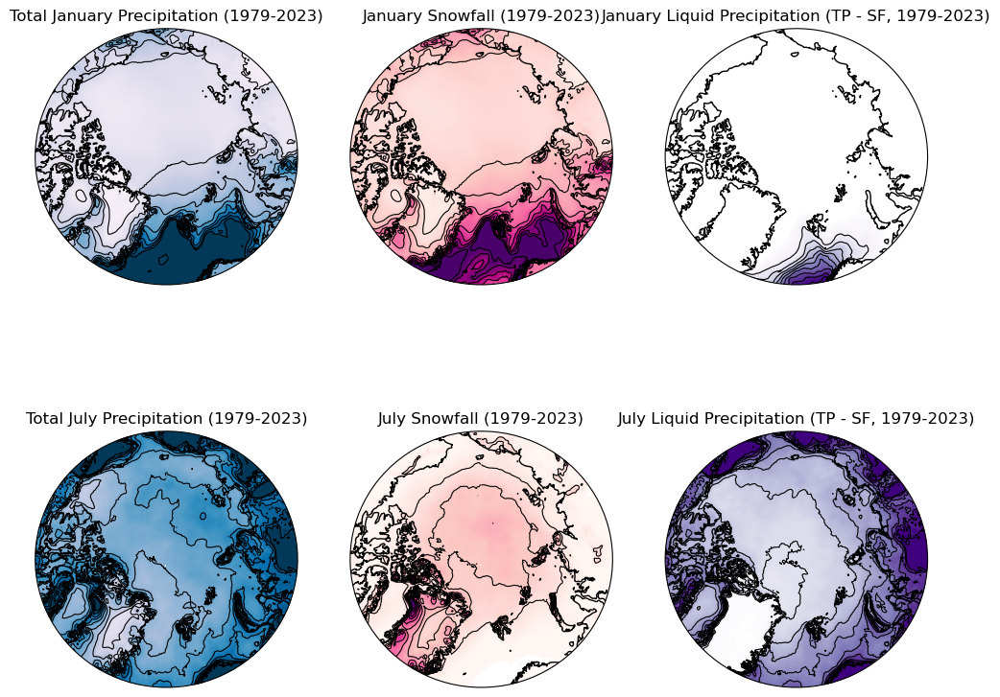

<Figure size 640x480 with 0 Axes>

In [25]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import matplotlib.path as mpath
import pandas as pd

# Define the plot function without contour labels and with adjustable colorbars
def plot_map(ax, data, title, vmin=0, vmax=100, cmap='PuBu', contour_levels=10, mask_threshold=0):
    ax.set_global()
    ax.coastlines()
    
    # Circular boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    
    # Set map extent
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Convert from meters to millimeters
    data_mm = data * 1000

    # Mask areas with low values of liquid precipitation to focus on the lower area
    data_mm = data_mm.where(data_mm > mask_threshold)

    # Plot the data
    pp = ax.pcolormesh(data_mm.longitude, data_mm.latitude, data_mm, 
                       cmap=cmap, transform=ccrs.PlateCarree(), vmin=vmin, vmax=vmax)

    # Add contour lines without labels
    contours = ax.contour(data_mm.longitude, data_mm.latitude, data_mm, 
                          levels=np.linspace(vmin, vmax, contour_levels), colors='black', linewidths=0.8, transform=ccrs.PlateCarree())

    # Add title without bold or special characters
    ax.set_title(title)

    return pp  # Return the pcolormesh to use for individual colorbars

# Convert 'date' to datetime64 if it's in integer format 
tp['date'] = pd.to_datetime(tp['date'].values, format='%Y%m%d')
sf['date'] = pd.to_datetime(sf['date'].values, format='%Y%m%d')
liquid_precip['date'] = pd.to_datetime(liquid_precip['date'].values, format='%Y%m%d')

# Filter data for January and July
january_data_tp = tp.sel(date=tp['date'].dt.month == 1)
january_data_sf = sf.sel(date=sf['date'].dt.month == 1)
january_data_liquid_precip = liquid_precip.sel(date=liquid_precip['date'].dt.month == 1)

july_data_tp = tp.sel(date=tp['date'].dt.month == 7)
july_data_sf = sf.sel(date=sf['date'].dt.month == 7)
july_data_liquid_precip = liquid_precip.sel(date=liquid_precip['date'].dt.month == 7)

# Create figure and 2x3 panel with smaller subplot size
fig, axes = plt.subplots(2, 3, figsize=(12, 10), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Plot January data
pp1 = plot_map(axes[0, 0], january_data_tp.sum(dim='date'), 'Total January Precipitation (1979-2023)', vmin=0, vmax=100)
pp2 = plot_map(axes[0, 1], january_data_sf.sum(dim='date'), 'January Snowfall (1979-2023)', vmin=0, vmax=100, cmap='RdPu')
pp3 = plot_map(axes[0, 2], january_data_liquid_precip.sum(dim='date'), 'January Liquid Precipitation (TP - SF, 1979-2023)', 
               vmin=0, vmax=100, cmap='Purples', mask_threshold=1)

# Plot July data
pp4 = plot_map(axes[1, 0], july_data_tp.sum(dim='date'), 'Total July Precipitation (1979-2023)', vmin=0, vmax=100)
pp5 = plot_map(axes[1, 1], july_data_sf.sum(dim='date'), 'July Snowfall (1979-2023)', vmin=0, vmax=100, cmap='RdPu')
pp6 = plot_map(axes[1, 2], july_data_liquid_precip.sum(dim='date'), 'July Liquid Precipitation (TP - SF, 1979-2023)', 
               vmin=0, vmax=100, cmap='Purples')

# Add individual colorbars for each color scheme, positioned below the subplots
#cbar1 = fig.colorbar(pp1, ax=[axes[0, 0], axes[1, 0]], orientation='horizontal', fraction=0.01, pad=0.2)
#cbar1.set_label('mm of water equivalent')

#cbar2 = fig.colorbar(pp2, ax=[axes[0, 1], axes[1, 1]], orientation='horizontal', fraction=0.05, pad=0.2)
#cbar2.set_label('mm of water equivalent')

#cbar3 = fig.colorbar(pp3, ax=[axes[0, 2], axes[1, 2]], orientation='horizontal', fraction=0.05, pad=0.2)
#cbar3.set_label('mm of water equivalent')

# Adjust layout to add more space between rows
#plt.tight_layout(h_pad=2.5)  # Increase vertical padding between rows

# Show the plot
plt.show()

# Save the figure
plt.savefig('JanuaryJulyArcticTotals_SpacedRows.png', dpi=300, bbox_inches='tight')


## Ratio

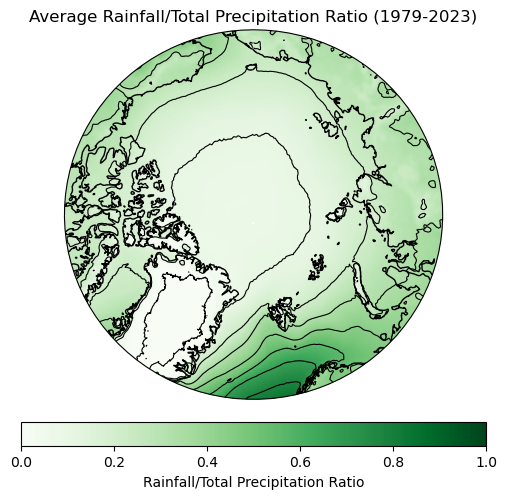

NameError: name 'pp' is not defined

In [26]:
# Step 1: Calculate Rainfall (Liquid Precipitation)
rainfall = tp - sf  # Total Precipitation minus Snowfall

# Step 2: Calculate the Ratio of Rainfall to Total Precipitation
# To avoid division by zero, mask out areas where total precipitation is zero
with xr.set_options(keep_attrs=True):
    ratio = rainfall / tp.where(tp != 0)

# Step 3: Calculate the Average Ratio over the period 1979-2023
# Average over the 'date' dimension 
average_ratio = ratio.mean(dim='date')

# Step 4: Plotting the Average Ratio using a polar map and adding contour lines
def plot_polar_map(data, title, cmap='coolwarm', vmin=0, vmax=1):
    fig = plt.figure(figsize=(6, 6))
    
    # Define a North Polar projection
    ax = plt.subplot(1, 1, 1, projection=ccrs.Orthographic(central_latitude=90))
    ax.coastlines()
    
    # Define circular boundary
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    
    # Set map extent (Arctic region)
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Plot the data using pcolormesh
    pp = ax.pcolormesh(data.longitude, data.latitude, data, transform=ccrs.PlateCarree(), cmap=cmap, vmin=vmin, vmax=vmax)
    
    # Add contour lines
    contours = ax.contour(data.longitude, data.latitude, data, transform=ccrs.PlateCarree(), colors='black', linewidths=0.8, levels=np.linspace(vmin, vmax, 10))
    
    # Add contour labels
    #ax.clabel(contours, inline=True, fontsize=8, fmt='%1.2f')

    # Add color bar
    cbar = plt.colorbar(pp, orientation='horizontal', pad=0.05)
    cbar.set_label('Rainfall/Total Precipitation Ratio')
    
    # Add title
    ax.set_title(title)
    
    plt.show()

# Call the plot function to visualize the average ratio with contour lines
plot_polar_map(average_ratio, 'Average Rainfall/Total Precipitation Ratio (1979-2023)', cmap='Greens', vmin=0, vmax=1)
, levels=np.linspace(vmin, vmax, 10))
    
    # Add contour labels
    #ax.clabel(contours, inline=True, fontsize=8, fmt='%1.2f')

    # Add color bar
cbar = plt.colorbar(pp, orientation='horizontal', pad=0.05)
cbar.set_label('Rainfall/Total Precipitation Ratio')
    
    # Add title
ax.set_title(title)
    
plt.show()

# Call the plot function to visualize the average ratio with contour lines
plot_polar_map(average_ratio, 'Average Rainfall/Total Precipitation Ratio (1979-2023)', cmap='YlGn', vmin=0, vmax=1)


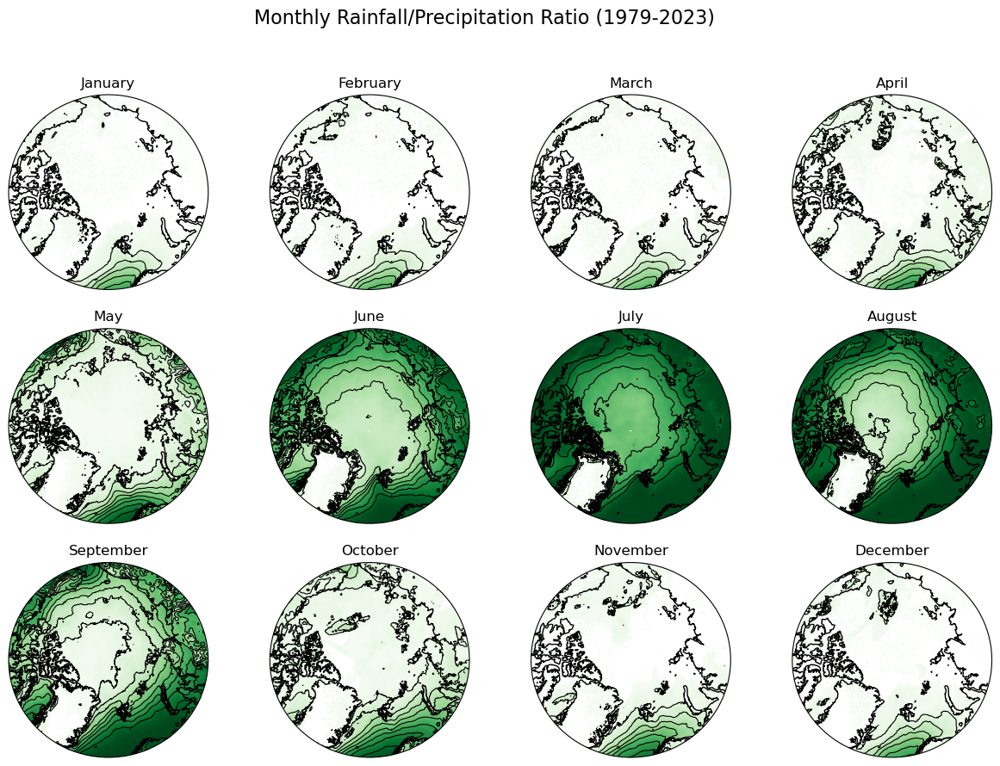

In [27]:
# Convert 'date' to datetime64 if it's in integer format (e.g., 19790101 -> datetime64)
tp['date'] = pd.to_datetime(tp['date'].values, format='%Y%m%d')
sf['date'] = pd.to_datetime(sf['date'].values, format='%Y%m%d')
liquid_precip['date'] = pd.to_datetime(liquid_precip['date'].values, format='%Y%m%d')

# Filter for the date range 1979-2023
tp = tp.sel(date=slice('1979-01-01', '2023-12-31'))
sf = sf.sel(date=slice('1979-01-01', '2023-12-31'))
liquid_precip = liquid_precip.sel(date=slice('1979-01-01', '2023-12-31'))


# Define a threshold to mask low rainfall ratios (e.g., 0.01)
mask_threshold = 0.01

# Calculate Rainfall-to-Total Precipitation Ratio
rainfall_ratio = liquid_precip / tp.where(tp != 0)

# Mask the ratio using the threshold to filter out small values
rainfall_ratio = rainfall_ratio.where(rainfall_ratio > mask_threshold)



# Function to plot monthly data in a polar projection
def plot_monthly_maps(data, title_prefix, cmap='Greens', vmin=0, vmax=1):
    fig, axes = plt.subplots(3, 4, figsize=(15, 10), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})
    months = ['January', 'February', 'March', 'April', 'May', 'June', 
              'July', 'August', 'September', 'October', 'November', 'December']
    
    for i, ax in enumerate(axes.flat):
        ax.coastlines()
        
        # Define a circular boundary for the polar projection
        theta = np.linspace(0, 2 * np.pi, 100)
        center, radius = [0.5, 0.5], 0.5
        verts = np.vstack([np.sin(theta), np.cos(theta)]).T
        circle = mpath.Path(verts * radius + center)
        ax.set_boundary(circle, transform=ax.transAxes)
        
        # Set extent (focus on the Arctic)
        ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())
        
        # Filter the data for the specific month
        month_data = data.sel(date=data['date'].dt.month == (i + 1)).mean(dim='date')
        
        # Plot the data
        pp = ax.pcolormesh(month_data.longitude, month_data.latitude, month_data, transform=ccrs.PlateCarree(), cmap=cmap, vmin=vmin, vmax=vmax)
        ax.set_title(months[i])
            # Add contour lines
        contours = ax.contour(month_data.longitude, month_data.latitude, month_data, transform=ccrs.PlateCarree(),
        colors='black', linewidths=0.8, levels=np.linspace(vmin, vmax, 10))
 

    plt.suptitle(f'{title_prefix} (1979-2023)', fontsize=16)
    plt.tight_layout
    plt.show()

plot_monthly_maps(rainfall_ratio, 'Monthly Rainfall/Precipitation Ratio')


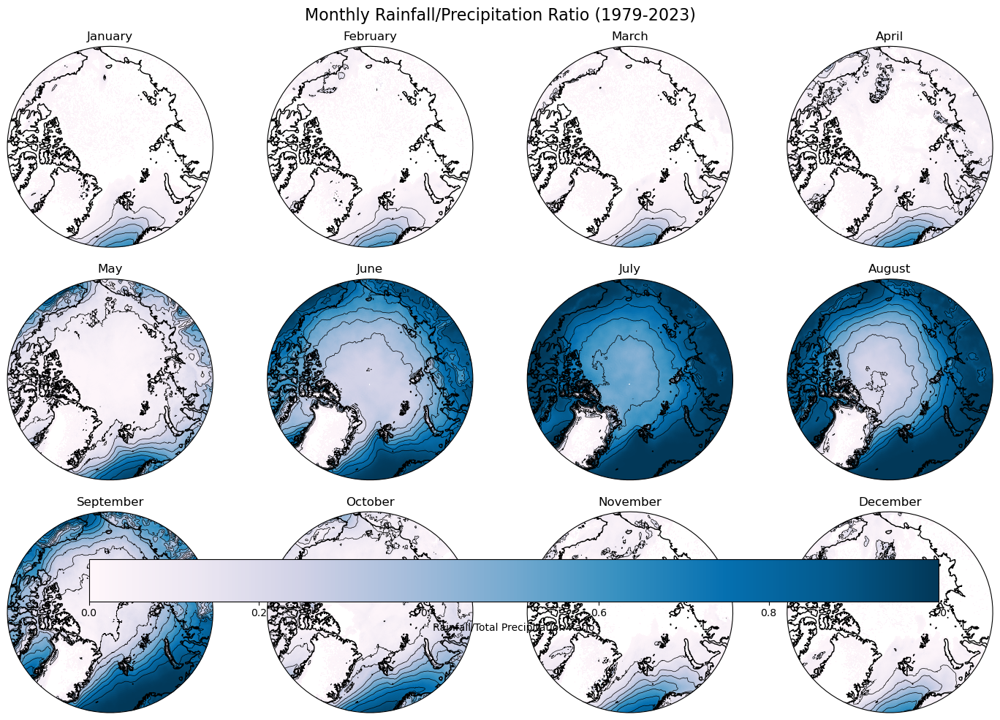

In [28]:
# Define a threshold to mask low rainfall ratios (e.g., 0.01)
mask_threshold = 0.01

# Convert 'date' to datetime64 if it's in integer format (e.g., 19790101 -> datetime64)
tp['date'] = pd.to_datetime(tp['date'].values, format='%Y%m%d')
sf['date'] = pd.to_datetime(sf['date'].values, format='%Y%m%d')
liquid_precip['date'] = pd.to_datetime(liquid_precip['date'].values, format='%Y%m%d')

# Filter for the date range 1979-2023
tp = tp.sel(date=slice('1979-01-01', '2023-12-31'))
sf = sf.sel(date=slice('1979-01-01', '2023-12-31'))
liquid_precip = liquid_precip.sel(date=slice('1979-01-01', '2023-12-31'))

# Calculate Rainfall-to-Total Precipitation Ratio
rainfall_ratio = liquid_precip / tp.where(tp != 0)

# Mask the ratio using the threshold to filter out small values
rainfall_ratio = rainfall_ratio.where(rainfall_ratio > mask_threshold)

# Function to plot monthly data in a polar projection
def plot_monthly_maps(data, title_prefix, cmap='PuBu', vmin=0, vmax=1):
    fig, axes = plt.subplots(3, 4, figsize=(15, 10), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})
    months = ['January', 'February', 'March', 'April', 'May', 'June', 
              'July', 'August', 'September', 'October', 'November', 'December']
    
    for i, ax in enumerate(axes.flat):
        ax.coastlines()
        
        # Define a circular boundary for the polar projection
        theta = np.linspace(0, 2 * np.pi, 100)
        center, radius = [0.5, 0.5], 0.5
        verts = np.vstack([np.sin(theta), np.cos(theta)]).T
        circle = mpath.Path(verts * radius + center)
        ax.set_boundary(circle, transform=ax.transAxes)
        
        # Set extent (focus on the Arctic)
        ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())
        
        # Filter the data for the specific month
        month_data = data.sel(date=data['date'].dt.month == (i + 1)).mean(dim='date')
        
        # Plot the data
        pp = ax.pcolormesh(month_data.longitude, month_data.latitude, month_data,
                           transform=ccrs.PlateCarree(), cmap=cmap, vmin=vmin, vmax=vmax)
        ax.set_title(months[i])
        
        # Add contour lines
        contours = ax.contour(month_data.longitude, month_data.latitude, month_data,
                              transform=ccrs.PlateCarree(), colors='black', linewidths=0.5,
                              levels=np.linspace(vmin, vmax, 10))


    # Add a color bar
    fig.colorbar(pp, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.03, label='Rainfall/Total Precipitation Ratio')

    plt.suptitle(f'{title_prefix} (1979-2023)', fontsize=16)
    plt.tight_layout()
    plt.show()

# Call the function to generate monthly maps with masking
plot_monthly_maps(rainfall_ratio, 'Monthly Rainfall/Precipitation Ratio')


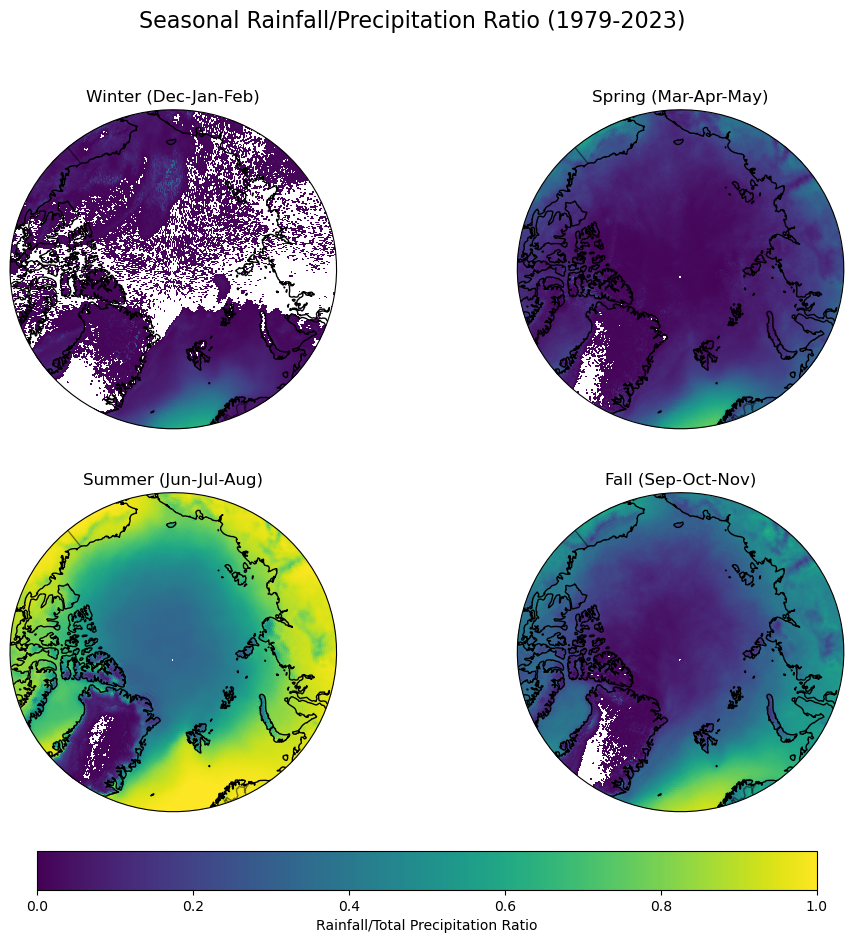

In [29]:

def plot_seasonal_maps(data, title_prefix, cmap='viridis', vmin=0, vmax=1):
    fig, axes = plt.subplots(2, 2, figsize=(12, 10), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})
    
    seasons = {
        'Winter (Dec-Jan-Feb)': [12, 1, 2],
        'Spring (Mar-Apr-May)': [3, 4, 5],
        'Summer (Jun-Jul-Aug)': [6, 7, 8],
        'Fall (Sep-Oct-Nov)': [9, 10, 11]
    }
    
    for ax, (season, months) in zip(axes.flat, seasons.items()):
        ax.coastlines()
        
        # Add country borders
        ax.add_feature(cfeature.BORDERS, linestyle='-', alpha=0.5)

        # Define a circular boundary for the polar projection
        theta = np.linspace(0, 2 * np.pi, 100)
        center, radius = [0.5, 0.5], 0.5
        verts = np.vstack([np.sin(theta), np.cos(theta)]).T
        circle = mpath.Path(verts * radius + center)
        ax.set_boundary(circle, transform=ax.transAxes)

        # Set extent (focus on the Arctic)
        ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())
        
        # Filter the data for the specific season
        season_data = data.sel(date=data['date'].dt.month.isin(months)).mean(dim='date')
        
        # Plot the data
        pp = ax.pcolormesh(season_data.longitude, season_data.latitude, season_data, transform=ccrs.PlateCarree(), cmap=cmap, vmin=vmin, vmax=vmax)
        ax.set_title(season)

    # Adjust layout to move the colorbar below the plot
    fig.subplots_adjust(bottom=0.1)


    # Add a color bar
    cbar = fig.colorbar(pp, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.05, fraction=0.05)
    cbar.set_label('Rainfall/Total Precipitation Ratio')

    plt.suptitle(f'{title_prefix} (1979-2023)', fontsize=16)
    plt.tight_layout
    plt.show()

plot_seasonal_maps(rainfall_ratio, 'Seasonal Rainfall/Precipitation Ratio')

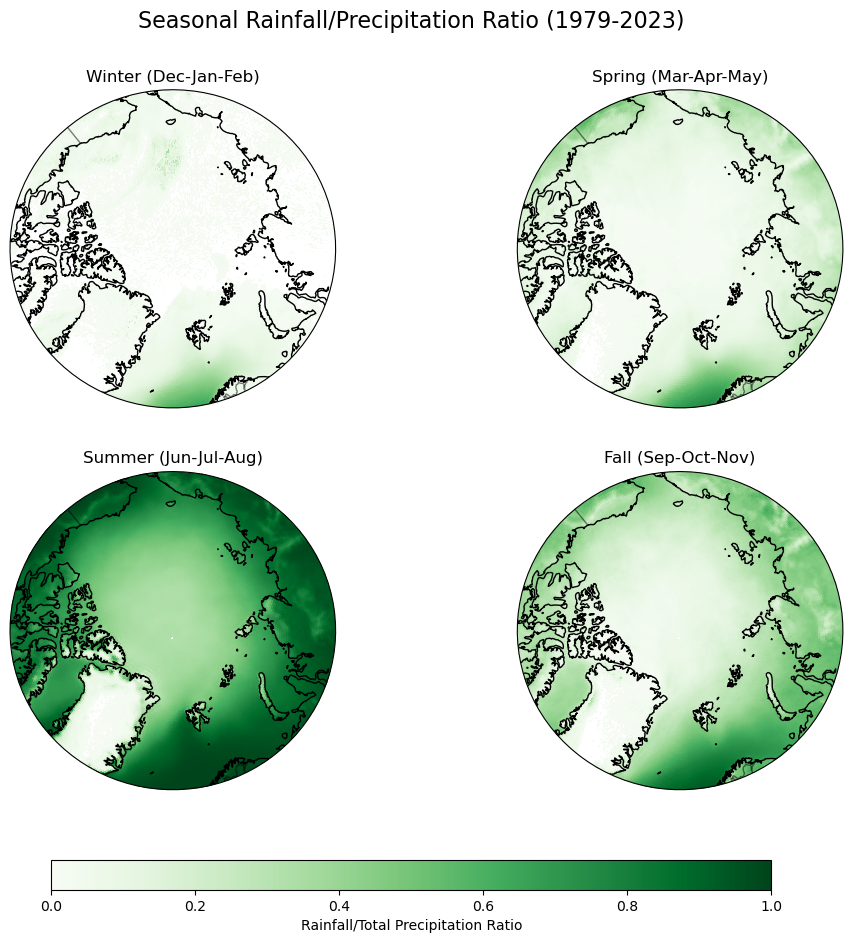

In [89]:
# Function to plot seasonal data with contour lines
def plot_seasonal_maps(data, title_prefix, cmap='Greens', vmin=0, vmax=1):
    fig, axes = plt.subplots(2, 2, figsize=(12, 10), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})
    seasons = {
        'Winter (Dec-Jan-Feb)': [12, 1, 2],
        'Spring (Mar-Apr-May)': [3, 4, 5],
        'Summer (Jun-Jul-Aug)': [6, 7, 8],
        'Fall (Sep-Oct-Nov)': [9, 10, 11]
    }
    
    for ax, (season, months) in zip(axes.flat, seasons.items()):
        ax.coastlines()
        ax.add_feature(cfeature.BORDERS, linestyle='-', alpha=0.5)

        # Define a circular boundary for the polar projection
        theta = np.linspace(0, 2 * np.pi, 100)
        center, radius = [0.5, 0.5], 0.5
        verts = np.vstack([np.sin(theta), np.cos(theta)]).T
        circle = mpath.Path(verts * radius + center)
        ax.set_boundary(circle, transform=ax.transAxes)
        
        # Set extent (focus on the Arctic)
        ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())
        
        # Filter the data for the specific season
        season_data = data.sel(date=data['date'].dt.month.isin(months)).mean(dim='date')

        # Plot the data
        pp = ax.pcolormesh(season_data.longitude, season_data.latitude, season_data, transform=ccrs.PlateCarree(),
                           cmap=cmap, vmin=vmin, vmax=vmax)

        # Add contour lines
        #contours = ax.contour(season_data.longitude, season_data.latitude, season_data, transform=ccrs.PlateCarree(),
                              #colors='black', linewidths=0.5, levels=np.linspace(vmin, vmax, 10))
        
        # Add title for each season
        ax.set_title(season)

    # Adjust layout to ensure space for the color bar
    plt.subplots_adjust(bottom=0.2, top=0.9)

    # Add a color bar below the entire figure using a dedicated axis
    cbar_ax = fig.add_axes([0.2, 0.1, 0.6, 0.03])  # Adjust left, bottom, width, height as needed
    cbar = fig.colorbar(pp, cax=cbar_ax, orientation='horizontal')
    cbar.set_label('Rainfall/Total Precipitation Ratio')

    # Set the title for the whole figure
    plt.suptitle(f'{title_prefix} (1979-2023)', fontsize=16)
    plt.show()

# Call the function to generate seasonal maps with viridis colormap and contour lines
plot_seasonal_maps(rainfall_ratio, 'Seasonal Rainfall/Precipitation Ratio')


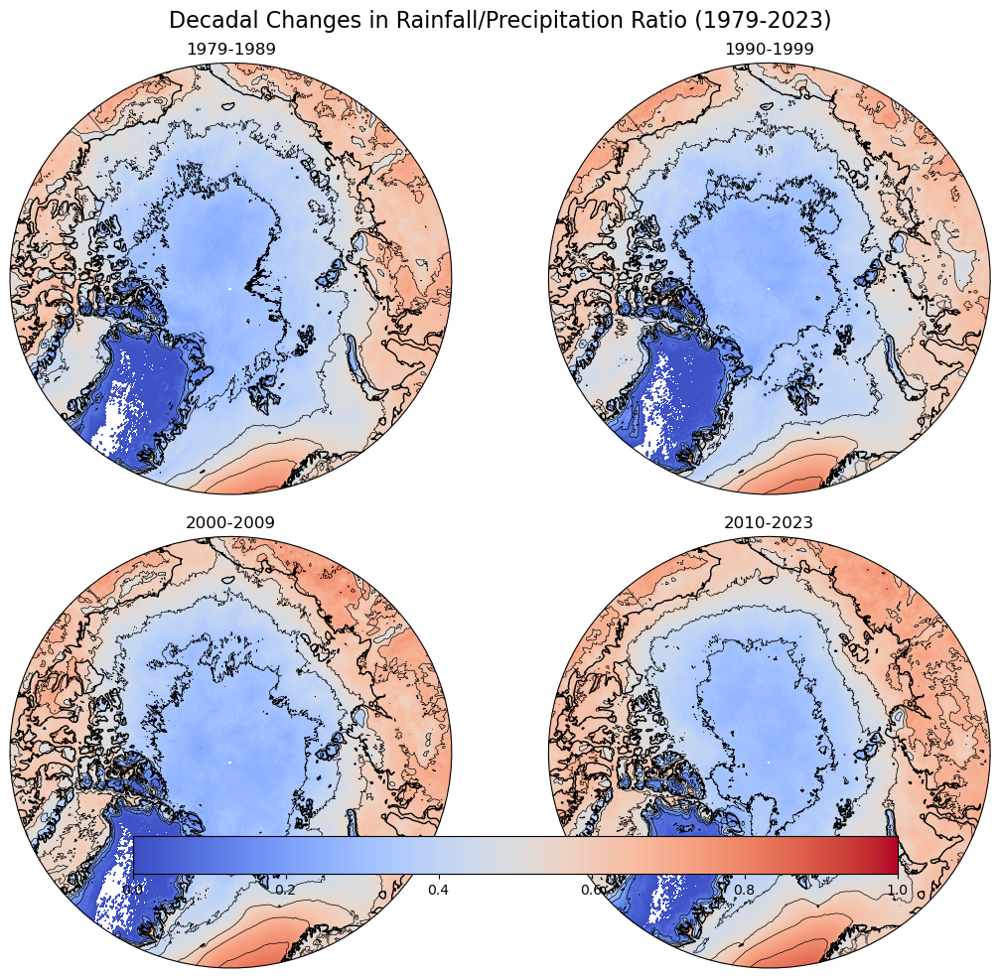

In [31]:
# Function to plot decadal maps with contour lines and degree labels
def plot_decadal_maps(data, title_prefix, cmap='coolwarm', vmin=0, vmax=1):
    decades = {
        '1979-1989': slice('1979-01-01', '1989-12-31'),
        '1990-1999': slice('1990-01-01', '1999-12-31'),
        '2000-2009': slice('2000-01-01', '2009-12-31'),
        '2010-2023': slice('2010-01-01', '2023-12-31')
    }

    # Set up a 2x2 grid for the four decades
    fig, axes = plt.subplots(2, 2, figsize=(12, 10), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

    # Function to plot data with contour lines and degree labels
    def plot_polar_map_with_contours_and_degrees(data, title, cmap='coolwarm', vmin=0, vmax=1, contour_levels=10):
        fig = plt.figure(figsize=(6, 6))
        # Add contour lines (no labels)
        contours = ax.contour(data.longitude, data.latitude, data, transform=ccrs.PlateCarree(),
                              colors='black', linewidths=0.5, levels=np.linspace(vmin, vmax, contour_levels))

    for ax, (decade, time_range) in zip(axes.flat, decades.items()):
        ax.coastlines()
        ax.add_feature(cfeature.BORDERS, linestyle='-', alpha=0.5)

        # Define a circular boundary for the polar projection
        theta = np.linspace(0, 2 * np.pi, 100)
        center, radius = [0.5, 0.5], 0.5
        verts = np.vstack([np.sin(theta), np.cos(theta)]).T
        circle = mpath.Path(verts * radius + center)
        ax.set_boundary(circle, transform=ax.transAxes)
        ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

        # Extract decadal data
        decadal_data = data.sel(date=time_range).mean(dim='date')

        # Plot the data
        pp = ax.pcolormesh(decadal_data.longitude, decadal_data.latitude, decadal_data, transform=ccrs.PlateCarree(), cmap=cmap, vmin=vmin, vmax=vmax)
        
        # Add contour lines
        contours = ax.contour(decadal_data.longitude, decadal_data.latitude, decadal_data, transform=ccrs.PlateCarree(),
                              colors='black', linewidths=0.5, levels=np.linspace(vmin, vmax, 10))

        # Set title for each subplot
        ax.set_title(decade)


    



    # Add overall figure title
    plt.suptitle(f'{title_prefix} (1979-2023)', fontsize=16)
    # Add a color bar across all plots
    fig.colorbar(pp, ax=axes.ravel().tolist(), orientation='horizontal', pad=0.05, fraction=0.05)
    # Adjust layout
    plt.tight_layout()
    plt.show()

plot_decadal_maps(rainfall_ratio, 'Decadal Changes in Rainfall/Precipitation Ratio')


In [32]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.path as mpath
import xarray as xr

# Define the function to plot decadal data with contour lines
def plot_decadal_maps(data, title_prefix, cmap='Greens', vmin=0, vmax=0.8):
    # Define time slices for each decade
    decades = {
        '1979-1989': slice('1979-01-01', '1989-12-31'),
        '1990-1999': slice('1990-01-01', '1999-12-31'),
        '2000-2009': slice('2000-01-01', '2009-12-31'),
        '2010-2023': slice('2010-01-01', '2023-12-31')
    }

    # Create a 2x2 grid of subplots with Orthographic projection centered on the North Pole
    fig, axes = plt.subplots(2, 2, figsize=(12, 10), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

    for ax, (decade, time_range) in zip(axes.flat, decades.items()):
        ax.coastlines()
        ax.add_feature(cfeature.BORDERS, linestyle='-', alpha=0.5)

        # Define a circular boundary for the polar projection
        theta = np.linspace(0, 2 * np.pi, 100)
        center, radius = [0.5, 0.5], 0.5
        verts = np.vstack([np.sin(theta), np.cos(theta)]).T
        circle = mpath.Path(verts * radius + center)
        ax.set_boundary(circle, transform=ax.transAxes)
        
        # Set extent to focus on the Arctic
        ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

        # Select data for the specific decade and calculate the mean
        decadal_data = data.sel(date=time_range).mean(dim='date')

        # Plot the data with the specified colormap
        pp = ax.pcolormesh(decadal_data.longitude, decadal_data.latitude, decadal_data, 
                           transform=ccrs.PlateCarree(), cmap=cmap, vmin=vmin, vmax=vmax)

        # Add contour lines
        contours = ax.contour(decadal_data.longitude, decadal_data.latitude, decadal_data, 
                              transform=ccrs.PlateCarree(), colors='black', linewidths=0.5, 
                              levels=np.linspace(vmin, vmax, 10))

        # Title for each subplot
        ax.set_title(decade)

    # Add a color bar below the entire figure
    cbar_ax = fig.add_axes([0.2, 0.05, 0.6, 0.02])  # Adjust the position and size (left, bottom, width, height)
    fig.colorbar(pp, cax=cbar_ax, orientation='horizontal', label='Rainfall/Total Precipitation Ratio')

    # Set a main title for the whole figure
    plt.suptitle(f'{title_prefix} (1979-2023)', fontsize=16)
    plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.15)  # Adjust layout for better spacing
    plt.show()

# Example usage (assuming rainfall_ratio data is already loaded)
# plot_decadal_maps(rainfall_ratio, 'Decadal Changes in Rainfall/Precipitation Ratio')


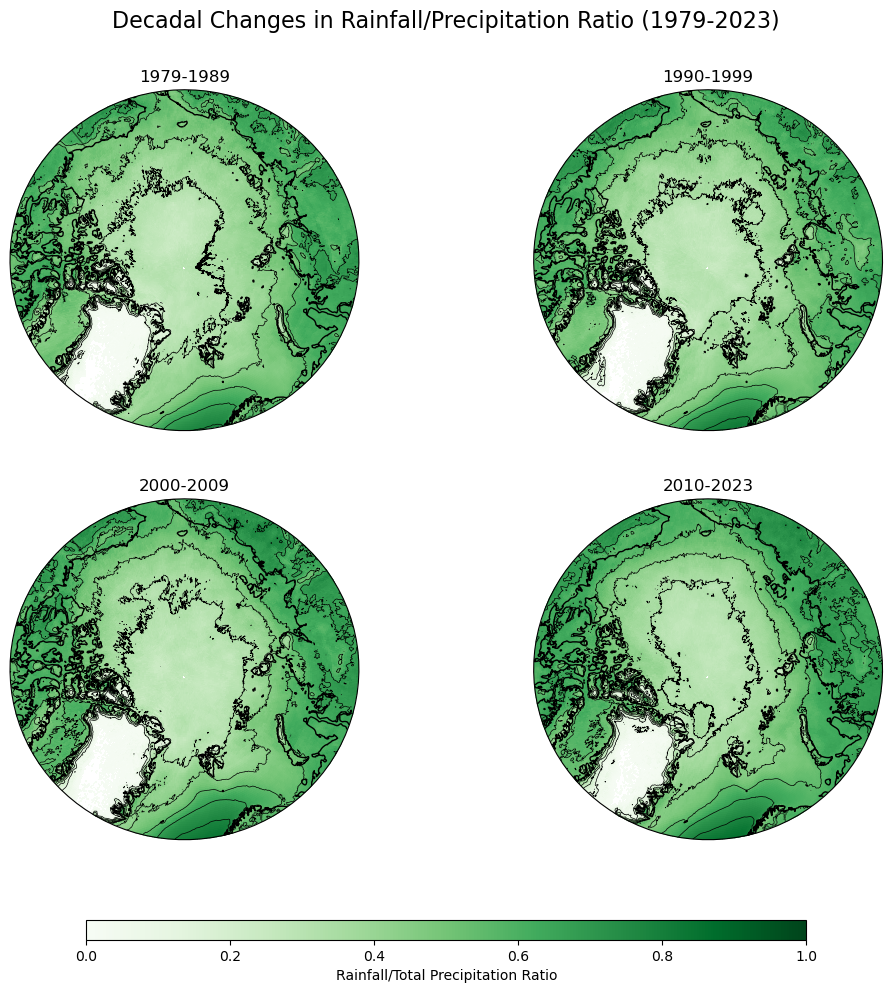

In [33]:
# Function to plot decadal data with contour lines
def plot_decadal_maps(data, title_prefix, cmap='Greens', vmin=0, vmax=1):
    decades = {
        '1979-1989': slice('1979-01-01', '1989-12-31'),
        '1990-1999': slice('1990-01-01', '1999-12-31'),
        '2000-2009': slice('2000-01-01', '2009-12-31'),
        '2010-2023': slice('2010-01-01', '2023-12-31')
    }

    # Create subplots in a 2x2 grid
    fig, axes = plt.subplots(2, 2, figsize=(12, 10), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

    for ax, (decade, time_range) in zip(axes.flat, decades.items()):
        ax.coastlines()
        ax.add_feature(cfeature.BORDERS, linestyle='-', alpha=0.5)

        # Define a circular boundary for the polar projection
        theta = np.linspace(0, 2 * np.pi, 100)
        center, radius = [0.5, 0.5], 0.5
        verts = np.vstack([np.sin(theta), np.cos(theta)]).T
        circle = mpath.Path(verts * radius + center)
        ax.set_boundary(circle, transform=ax.transAxes)
        
        # Set extent (focus on the Arctic)
        ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

        # Select data for the specific decade and calculate the mean
        decadal_data = data.sel(date=time_range).mean(dim='date')

        # Plot the data
        pp = ax.pcolormesh(decadal_data.longitude, decadal_data.latitude, decadal_data, transform=ccrs.PlateCarree(),
                           cmap=cmap, vmin=vmin, vmax=vmax)

        # Add contour lines
        contours = ax.contour(decadal_data.longitude, decadal_data.latitude, decadal_data, transform=ccrs.PlateCarree(),
                              colors='black', linewidths=0.5, levels=np.linspace(vmin, vmax, 10))

        # Add title for each decade
        ax.set_title(decade)

    # Add a color bar below the entire figure
    cbar_ax = fig.add_axes([0.2, 0.05, 0.6, 0.02])  # Adjust the position and size (left, bottom, width, height)
    fig.colorbar(pp, cax=cbar_ax, orientation='horizontal', label='Rainfall/Total Precipitation Ratio')

    # Set the title for the whole figure
    plt.suptitle(f'{title_prefix} (1979-2023)', fontsize=16)
    plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.15)  # Adjust the layout for better spacing
    plt.show()

plot_decadal_maps(rainfall_ratio, 'Decadal Changes in Rainfall/Precipitation Ratio')


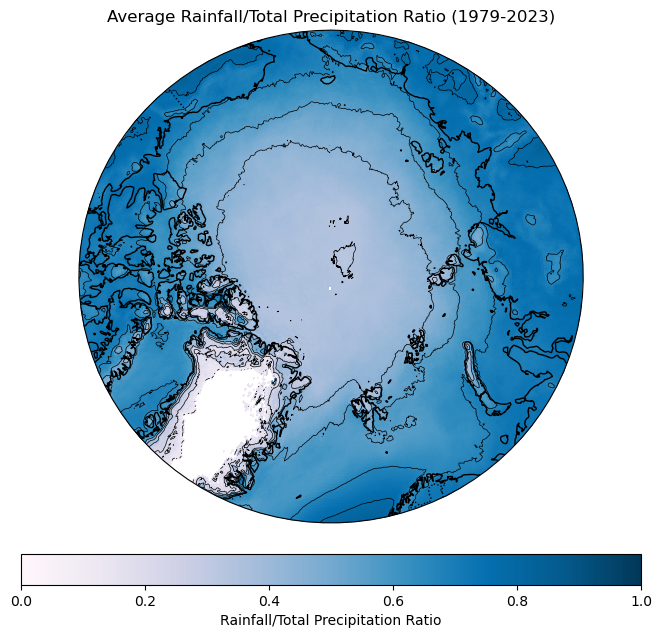

In [34]:
# Mask out zeros or near-zero values to reduce noise
masked_rainfall_ratio = xr.where(rainfall_ratio > 0.1, rainfall_ratio, np.nan)

# Function to plot polar map with contours
def plot_polar_map_with_contours_and_degrees(data, title, cmap='PuBu', vmin=0, vmax=1, contour_levels=None):
    fig, ax = plt.subplots(figsize=(8, 8), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})
    
    # Define a circular boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)

    # Set extent (focus on the Arctic)
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Add coastlines and reduce noise in Greenland by masking
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS, linestyle=':', edgecolor='black') # Optional, adds borders for clarity

    # Plot the data and masked zero values
    pp = ax.pcolormesh(data.longitude, data.latitude, data, transform=ccrs.PlateCarree(), cmap=cmap, vmin=vmin, vmax=vmax)

    # Add contour lines
    if contour_levels is not None:
        ax.contour(data.longitude, data.latitude, data, transform=ccrs.PlateCarree(), colors='black', linewidths=0.5, levels=contour_levels)

    # Add a color bar
    cbar = fig.colorbar(pp, ax=ax, orientation='horizontal', pad=0.05)
    cbar.set_label('Rainfall/Total Precipitation Ratio')

    # Set title
    ax.set_title(title)

    plt.show()

plot_polar_map_with_contours_and_degrees(masked_rainfall_ratio.mean(dim='date'), 
                                         'Average Rainfall/Total Precipitation Ratio (1979-2023)',
                                         cmap='PuBu', vmin=0, vmax=1, contour_levels=np.linspace(0, 1, 10))



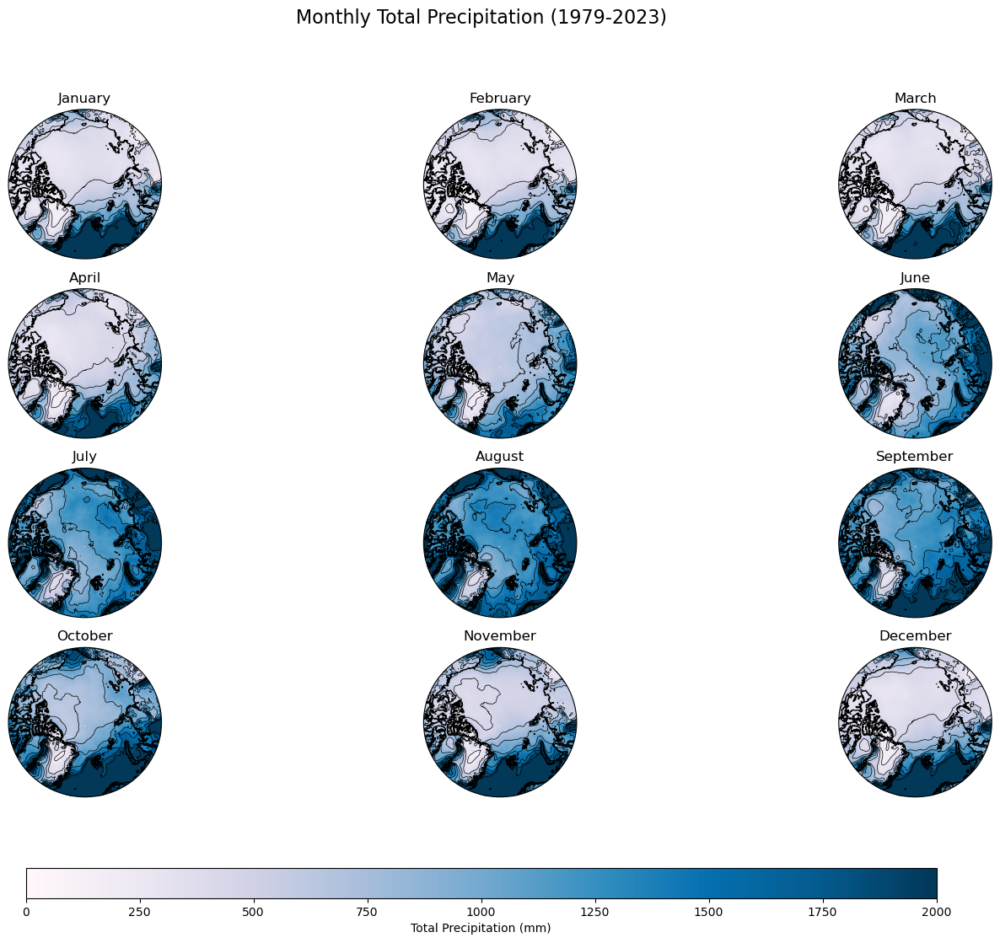

In [35]:
def plot_monthly_precipitation(data, title_prefix, cmap='PuBu', vmin=0, vmax=2000):
    fig, axes = plt.subplots(4, 3, figsize=(18, 12), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})
    months = ['January', 'February', 'March', 'April', 'May', 'June',
              'July', 'August', 'September', 'October', 'November', 'December']
    
    for i, ax in enumerate(axes.flat):
        ax.coastlines()
        ax.add_feature(cfeature.BORDERS, linestyle='-', alpha=0.5)

        # Define a circular boundary for the polar projection
        theta = np.linspace(0, 2 * np.pi, 100)
        center, radius = [0.5, 0.5], 0.5
        verts = np.vstack([np.sin(theta), np.cos(theta)]).T
        circle = mpath.Path(verts * radius + center)
        ax.set_boundary(circle, transform=ax.transAxes)
        
        # Set extent (focus on the Arctic)
        ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())
        
        # Filter the data for the specific month and calculate the mean over time
        month_data = data.sel(date=data['date'].dt.month == (i + 1)).mean(dim='date')

        # Convert from meters to millimeters for precipitation (if needed)
        data_mm = month_data * 1000 * 1000

        # Plot the data using the PuBu colormap
        pp = ax.pcolormesh(data_mm.longitude, data_mm.latitude, data_mm, transform=ccrs.PlateCarree(),
                           cmap=cmap, vmin=vmin, vmax=vmax)

        # Add contour lines
        contours = ax.contour(data_mm.longitude, data_mm.latitude, data_mm, transform=ccrs.PlateCarree(),
                              colors='black', linewidths=0.5, levels=np.linspace(vmin, vmax, 10))
        
        # Add title for each month
        ax.set_title(months[i])

    # Adjust layout to move the color bar below the plot
    fig.subplots_adjust(bottom=0.2)

    # Add a color bar below the entire figure using a dedicated axis
    cbar_ax = fig.add_axes([0.2, 0.1, 0.6, 0.03])  # position and size (left, bottom, width, height)
    cbar = fig.colorbar(pp, cax=cbar_ax, orientation='horizontal')
    cbar.set_label('Total Precipitation (mm)')

    # Set the title for the whole figure
    plt.suptitle(f'{title_prefix} (1979-2023)', fontsize=16)
    plt.show()

plot_monthly_precipitation(tp, 'Monthly Total Precipitation', cmap='PuBu', vmin=0, vmax=2000)


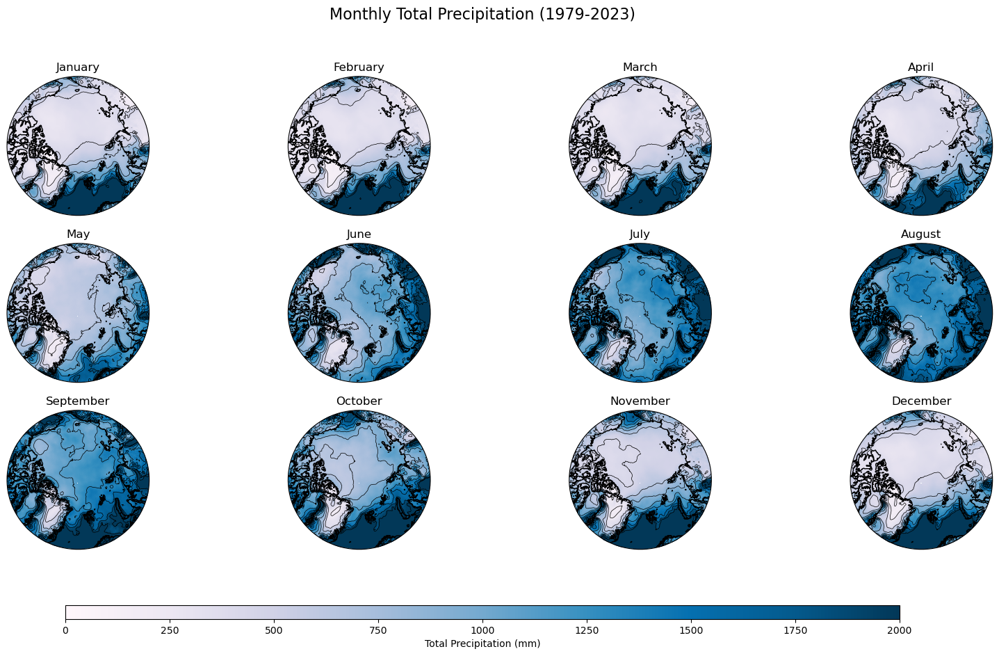

In [36]:
# Function to plot monthly total precipitation data with the PuBu colormap
def plot_monthly_precipitation(data, title_prefix, cmap='PuBu', vmin=0, vmax=2000):
    fig, axes = plt.subplots(3, 4, figsize=(20, 10), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})
    months = ['January', 'February', 'March', 'April', 'May', 'June',
              'July', 'August', 'September', 'October', 'November', 'December']
    
    for i, ax in enumerate(axes.flat):
        ax.coastlines()
        ax.add_feature(cfeature.BORDERS, linestyle='-', alpha=0.5)

        # Define a circular boundary for the polar projection
        theta = np.linspace(0, 2 * np.pi, 100)
        center, radius = [0.5, 0.5], 0.5
        verts = np.vstack([np.sin(theta), np.cos(theta)]).T
        circle = mpath.Path(verts * radius + center)
        ax.set_boundary(circle, transform=ax.transAxes)
        
        # Set extent (focus on the Arctic)
        ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())
        
        # Filter the data for the specific month and calculate the mean over time
        month_data = data.sel(date=data['date'].dt.month == (i + 1)).mean(dim='date')

        # Convert from meters to millimeters for precipitation (if needed)
        data_mm = month_data * 1000 * 1000

        # Plot the data using the PuBu colormap
        pp = ax.pcolormesh(data_mm.longitude, data_mm.latitude, data_mm, transform=ccrs.PlateCarree(),
                           cmap=cmap, vmin=vmin, vmax=vmax)

        # Add contour lines
        contours = ax.contour(data_mm.longitude, data_mm.latitude, data_mm, transform=ccrs.PlateCarree(),
                              colors='black', linewidths=0.5, levels=np.linspace(vmin, vmax, 10))
        
        # Add title for each month
        ax.set_title(months[i])

    # Adjust layout to move the color bar below the plot
    fig.subplots_adjust(bottom=0.2)

    # Add a color bar below the entire figure using a dedicated axis
    cbar_ax = fig.add_axes([0.2, 0.1, 0.6, 0.02])  # position and size (left, bottom, width, height)
    cbar = fig.colorbar(pp, cax=cbar_ax, orientation='horizontal')
    cbar.set_label('Total Precipitation (mm)')

    # Set the title for the whole figure
    plt.suptitle(f'{title_prefix} (1979-2023)', fontsize=16)
    plt.show()

plot_monthly_precipitation(tp, 'Monthly Total Precipitation', cmap='PuBu', vmin=0, vmax=2000)


In [37]:
# Function to plot data in a polar projection
def plot_trend_polar(data, title, vmin=-5e-5, vmax=5e-5):
    plt.figure(figsize=(8, 8))
    ax = plt.subplot(1, 1, 1, projection=ccrs.Orthographic(central_latitude=90))
    ax.coastlines()

    # Circular boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)

    # Set extent to focus on the Arctic region
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Plot the data in polar projection
    trend_plot = ax.pcolormesh(
        data.longitude,
        data.latitude,
        data,
        transform=ccrs.PlateCarree(),
        cmap='RdBu',
        vmin=vmin,
        vmax=vmax,
        shading='auto'
    )

    # Add colorbar
    cbar = plt.colorbar(trend_plot, orientation='horizontal', pad=0.05)
    cbar.set_label('Trend (units per year)')

    # Title
    ax.set_title(title, fontsize=14)

    plt.show()

# Plot each trend map using the polar projection
plot_trend_polar(trend, 'Total Precipitation Trend (1979-2023)')
plot_trend_polar(sf_trend, 'Snowfall Trend (1979-2023)')
plot_trend_polar(lp_trend, 'Liquid Precipitation Trend (1979-2023)')


NameError: name 'trend' is not defined

NameError: name 'tp_trend' is not defined

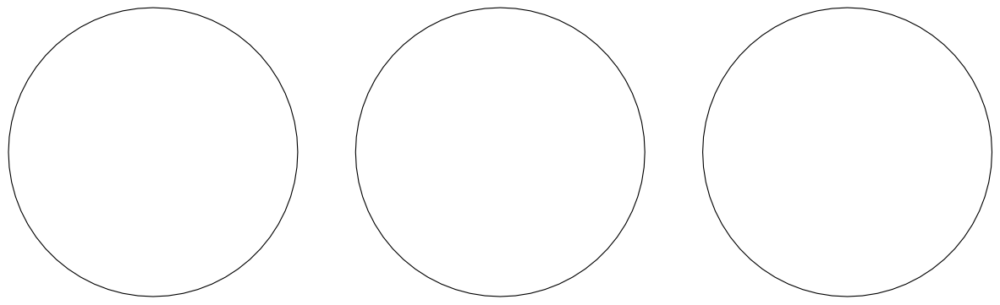

In [38]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import matplotlib.path as mpath
import numpy as np

# Function to plot a single trend map in polar projection
def plot_trend_polar(ax, data, title, vmin=-5e-5, vmax=5e-5):
    ax.coastlines()
    
    # Define circular boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)

    # Set extent to focus on the Arctic region
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())
    
    # Plot data
    trend_plot = ax.pcolormesh(
        data.longitude,
        data.latitude,
        data,
        transform=ccrs.PlateCarree(),
        cmap='RdBu',
        vmin=vmin,
        vmax=vmax,
        shading='auto'
    )

    # Add title for each subplot
    ax.set_title(title, fontsize=14)

    return trend_plot

# Create subplots
fig, axes = plt.subplots(1, 3, figsize=(15, 6), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Plot each trend map in a separate subplot
tp_trend_plot = plot_trend_polar(axes[0], tp_trend, 'Total Precipitation Trend (1979-2023)')
sf_trend_plot = plot_trend_polar(axes[1], sf_trend, 'Snowfall Trend (1979-2023)')
lp_trend_plot = plot_trend_polar(axes[2], lp_trend, 'Liquid Precipitation Trend (1979-2023)')

# Adjust layout and add a colorbar below all plots
fig.subplots_adjust(bottom=0.2, wspace=0.1)
cbar_ax = fig.add_axes([0.25, 0.1, 0.5, 0.03])  # Position and size of colorbar
cbar = fig.colorbar(tp_trend_plot, cax=cbar_ax, orientation='horizontal')
cbar.set_label('Trend (units per year)')

plt.show()


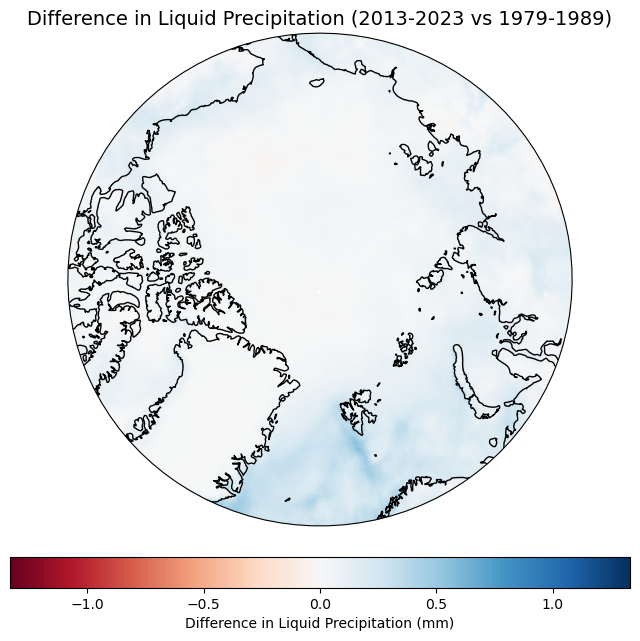

In [39]:
# Selecting the data for the first and last decades
first_decade = liquid_precip.sel(date=slice('1979-01-01', '1989-12-31'))
last_decade = liquid_precip.sel(date=slice('2013-01-01', '2023-12-31'))

# Compute the mean liquid precipitation for each decade
first_decade_mean = first_decade.mean(dim='date')
last_decade_mean = last_decade.mean(dim='date')

# Calculate the difference between the last and first decade and multiply by 1000
lp_difference = (last_decade_mean - first_decade_mean) * 1000  # Converts to mm if data is in meters

# Plotting the difference with a polar projection
plt.figure(figsize=(8, 8))
ax = plt.subplot(1, 1, 1, projection=ccrs.Orthographic(central_latitude=90))
ax.coastlines()

# Define a circular boundary for the polar projection
theta = np.linspace(0, 2 * np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)

# Set the map extent to focus on the Arctic region
ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

# Plot the difference data
lp_diff_plot = ax.pcolormesh(
    lp_difference.longitude,
    lp_difference.latitude,
    lp_difference,
    transform=ccrs.PlateCarree(),
    cmap='RdBu',
    vmin=-np.abs(lp_difference).max(),  # Symmetric color scale around zero
    vmax=np.abs(lp_difference).max(),
    shading='auto'
)

# Add a colorbar
cbar = plt.colorbar(lp_diff_plot, orientation='horizontal', pad=0.05)
cbar.set_label('Difference in Liquid Precipitation (mm)')

# Title
ax.set_title('Difference in Liquid Precipitation (2013-2023 vs 1979-1989)', fontsize=14)

plt.show()


NameError: name 'tp_trend' is not defined

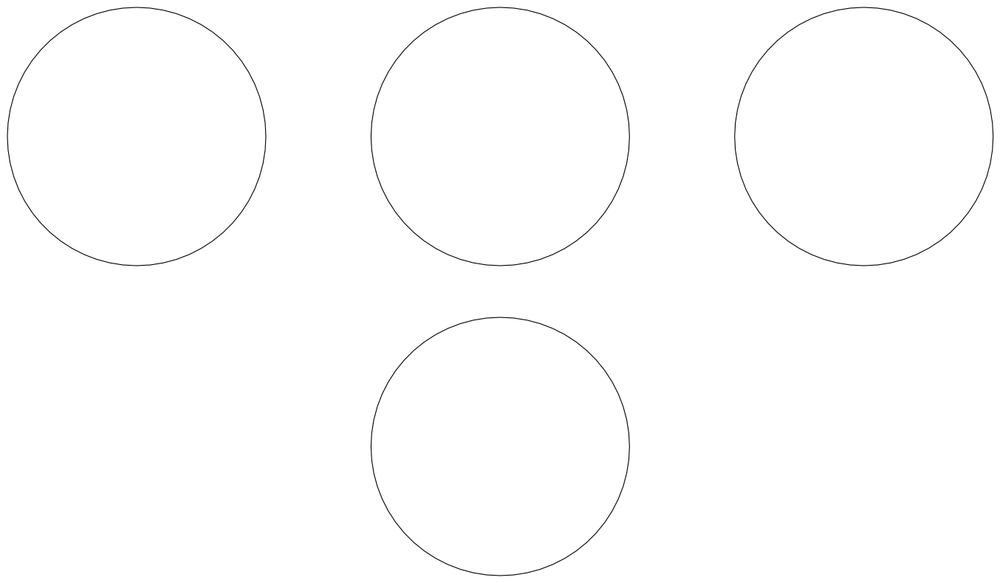

In [40]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import matplotlib.path as mpath

# Function to plot each data on a polar projection with a specific axis
def plot_trend_polar(ax, data, title, vmin=-5e-5, vmax=5e-5, cmap='RdBu', colorbar_label='Trend (units per year)'):
    ax.coastlines()

    # Circular boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)

    # Set extent to focus on the Arctic region
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Plot the data in polar projection
    trend_plot = ax.pcolormesh(
        data.longitude,
        data.latitude,
        data,
        transform=ccrs.PlateCarree(),
        cmap=cmap,
        vmin=vmin,
        vmax=vmax,
        shading='auto'
    )

    # Title
    ax.set_title(title, fontsize=14)
    
    return trend_plot

# Define figure and axes: 1 row for 3 side-by-side plots, and 1 row for the last plot
fig = plt.figure(figsize=(18, 10))

# Axes for the three side-by-side trend maps
ax1 = fig.add_subplot(2, 3, 1, projection=ccrs.Orthographic(central_latitude=90))
ax2 = fig.add_subplot(2, 3, 2, projection=ccrs.Orthographic(central_latitude=90))
ax3 = fig.add_subplot(2, 3, 3, projection=ccrs.Orthographic(central_latitude=90))

# Axes for the difference plot in the second row
ax4 = fig.add_subplot(2, 1, 2, projection=ccrs.Orthographic(central_latitude=90))

# Plot each trend map
tp_plot = plot_trend_polar(ax1, tp_trend, 'Total Precipitation Trend (1979-2023)')
sf_plot = plot_trend_polar(ax2, sf_trend, 'Snowfall Trend (1979-2023)')
lp_plot = plot_trend_polar(ax3, lp_trend, 'Liquid Precipitation Trend (1979-2023)')

# Selecting the data for the first and last decades for difference plot
first_decade = liquid_precip.sel(date=slice('1979-01-01', '1989-12-31')).mean(dim='date')
last_decade = liquid_precip.sel(date=slice('2013-01-01', '2023-12-31')).mean(dim='date')
lp_difference = (last_decade - first_decade) * 1000  # Convert to mm if data is in meters

# Plot the difference between last and first decade
lp_diff_plot = plot_trend_polar(
    ax4, lp_difference, 'Difference in Liquid Precipitation (2013-2023 vs 1979-1989)',
    vmin=-np.abs(lp_difference).max(), vmax=np.abs(lp_difference).max(), cmap='BrBG', colorbar_label='Difference in Liquid Precipitation (mm)'
)

# Add colorbars for the trends and difference plot
cbar1 = fig.colorbar(tp_plot, ax=[ax1, ax2, ax3], orientation='horizontal', pad=0.1, aspect=40)
cbar1.set_label('Trend (units per year)')

cbar2 = fig.colorbar(lp_diff_plot, ax=ax4, orientation='horizontal', pad=0.1, aspect=40)
cbar2.set_label('Difference in Liquid Precipitation (mm)')

# Set main title
plt.suptitle("Trend and Decadal Difference Analysis (1979-2023)", fontsize=16, y=0.95)

# Adjust layout for better spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
plt.show()


NameError: name 'tp_trend' is not defined

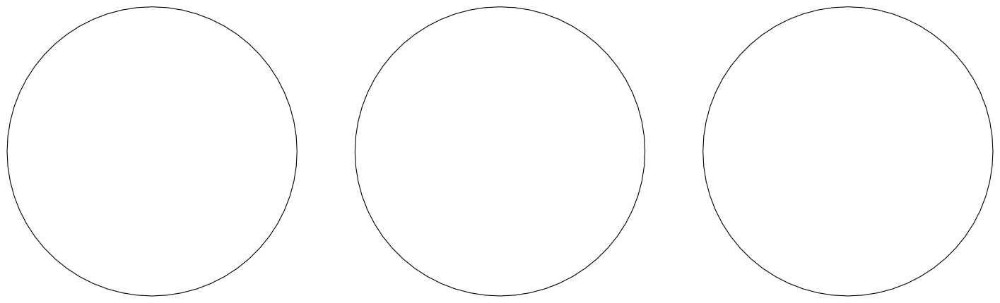

In [41]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import matplotlib.path as mpath

# Function to plot each data on a polar projection with a specific axis
def plot_trend_polar(ax, data, title, vmin=-5e-5, vmax=5e-5, cmap='RdBu'):
    ax.coastlines()

    # Circular boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)

    # Set extent to focus on the Arctic region
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Plot the data in polar projection
    trend_plot = ax.pcolormesh(
        data.longitude,
        data.latitude,
        data,
        transform=ccrs.PlateCarree(),
        cmap=cmap,
        vmin=vmin,
        vmax=vmax,
        shading='auto'
    )

    # Title
    ax.set_title(title, fontsize=14)
    
    return trend_plot

# Define figure and axes for 1 row of 3 side-by-side plots
fig, axes = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Plot each trend map side by side
tp_plot = plot_trend_polar(axes[0], tp_trend, 'Total Precipitation Trend (1979-2023)')
sf_plot = plot_trend_polar(axes[1], sf_trend, 'Snowfall Trend (1979-2023)')
lp_plot = plot_trend_polar(axes[2], lp_trend, 'Liquid Precipitation Trend (1979-2023)')

# Add a colorbar below the three plots with extra padding and aspect
#cbar = fig.colorbar(tp_plot, ax=axes, orientation='horizontal', pad=0.95, aspect=40)  # Increased padding here
#cbar.set_label('Trend (units per year)')

# Set main title
#plt.suptitle("Trend Analysis (1979-2023)", fontsize=16, y=1.05)

# Adjust layout for additional spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.85, bottom=0.2)  # Increased bottom margin here
plt.show()


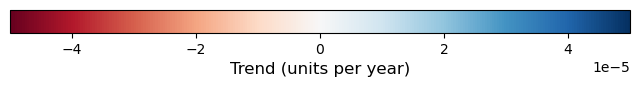

In [42]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.colorbar as colorbar
import matplotlib.colors as mcolors

# Set the color limits to match the trend data
vmin, vmax = -5e-5, 5e-5

# Create a figure for the colorbar
fig, ax = plt.subplots(figsize=(8, 0.3))

# Define the colormap and normalization
cmap = 'RdBu'
norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

# Create a colorbar on its own
cbar = colorbar.ColorbarBase(ax, cmap=cmap, norm=norm, orientation='horizontal')
cbar.set_label('Trend (units per year)', fontsize=12)

# Display the colorbar
plt.show()


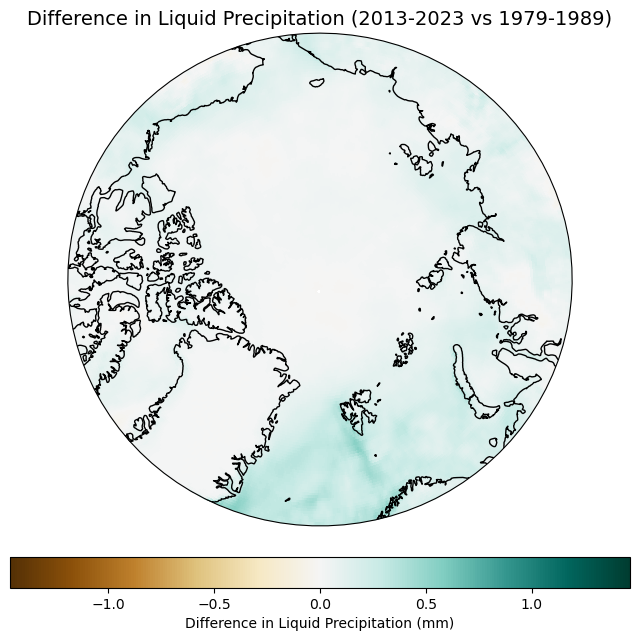

In [17]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import matplotlib.path as mpath

# Assuming `liquid_precip` is the data array for liquid precipitation with a 'date' dimension

# Selecting data for the first and last decades
first_decade = liquid_precip.sel(date=slice('1979-01-01', '1989-12-31')).mean(dim='date')
last_decade = liquid_precip.sel(date=slice('2013-01-01', '2023-12-31')).mean(dim='date')

# Calculate the difference and multiply by 1000 to convert to mm if data is in meters
lp_difference = (last_decade - first_decade) * 1000  # Convert to mm

# Create the plot
fig = plt.figure(figsize=(8, 8))
ax = plt.subplot(1, 1, 1, projection=ccrs.Orthographic(central_latitude=90))
ax.coastlines()

# Define a circular boundary for the polar projection
theta = np.linspace(0, 2 * np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)

# Set the extent to focus on the Arctic region
ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

# Plot the difference data
vmin, vmax = -np.abs(lp_difference).max(), np.abs(lp_difference).max()  # Symmetric color scale around zero
lp_diff_plot = ax.pcolormesh(
    lp_difference.longitude,
    lp_difference.latitude,
    lp_difference,
    transform=ccrs.PlateCarree(),
    cmap='BrBG',  # Choose a diverging colormap for differences
    vmin=vmin,
    vmax=vmax,
    shading='auto'
)

# Add a colorbar below the plot
cbar = plt.colorbar(lp_diff_plot, orientation='horizontal', pad=0.05)
cbar.set_label('Difference in Liquid Precipitation (mm)')

# Title
ax.set_title('Difference in Liquid Precipitation (2013-2023 vs 1979-1989)', fontsize=14)

plt.show()


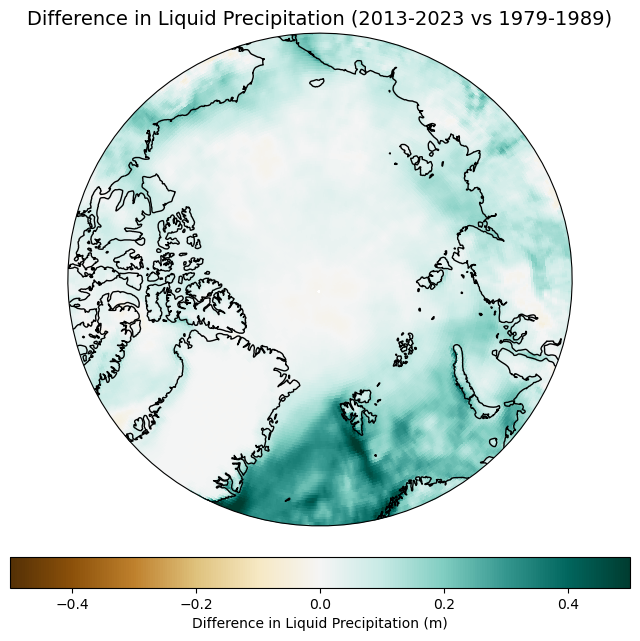

In [33]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import matplotlib.path as mpath

# Assuming `liquid_precip` is the data array for liquid precipitation with a 'date' dimension

# Selecting data for the first and last decades
first_decade = liquid_precip.sel(date=slice('1979-01-01', '1989-12-31')).mean(dim='date')
last_decade = liquid_precip.sel(date=slice('2013-01-01', '2023-12-31')).mean(dim='date')

# Calculate the difference and multiply by 1000 to convert to mm if data is in meters
lp_difference = (last_decade - first_decade) * 1000  # Convert to mm

# Create the plot
fig = plt.figure(figsize=(8, 8))
ax = plt.subplot(1, 1, 1, projection=ccrs.Orthographic(central_latitude=90))
ax.coastlines()

# Define a circular boundary for the polar projection
theta = np.linspace(0, 2 * np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)

# Set the extent to focus on the Arctic region
ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

# Set the scale to -0.5 mm to 0.5 mm
vmin, vmax = -0.5, 0.5  

# Plot the difference data
lp_diff_plot = ax.pcolormesh(
    lp_difference.longitude,
    lp_difference.latitude,
    lp_difference,
    transform=ccrs.PlateCarree(),
    cmap='BrBG',  # Choose a diverging colormap for differences
    vmin=vmin,
    vmax=vmax,
    shading='auto'
)

# Add a colorbar below the plot
cbar = plt.colorbar(lp_diff_plot, orientation='horizontal', pad=0.05)
cbar.set_label('Difference in Liquid Precipitation (m)')

# Title
ax.set_title('Difference in Liquid Precipitation (2013-2023 vs 1979-1989)', fontsize=14)

plt.show()



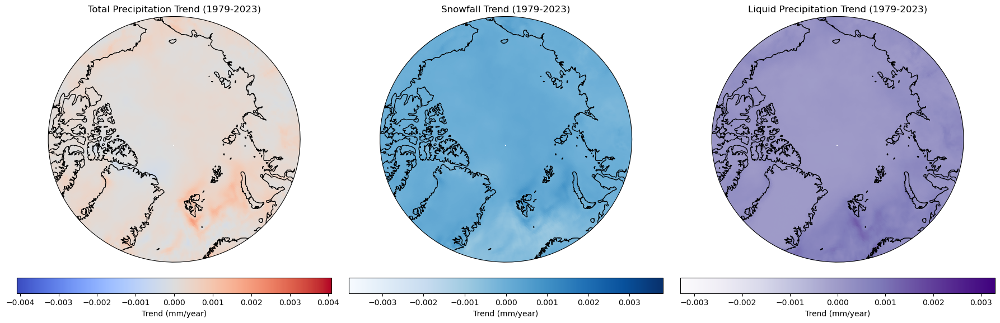

In [45]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import matplotlib.path as mpath
from scipy.stats import linregress

# Assuming `tp` (total precipitation), `sf` (snowfall), and `liquid_precip` (calculated as `tp - sf`)
# are already defined DataArrays with dimensions (time, latitude, longitude)

# Define a function to calculate the linear trend for each grid cell
def calculate_trend(data):
    """Calculate linear trend (slope) over time at each grid point."""
    time = np.arange(data.shape[0])  # Create a time array (e.g., 0, 1, 2, ...)
    slopes = np.apply_along_axis(lambda y: linregress(time, y).slope, axis=0, arr=data)
    return slopes

# Calculate trends for each variable (mm/year)
tp_trend = calculate_trend(tp) * 1000  # Convert to mm/year if needed
sf_trend = calculate_trend(sf) * 1000  # Convert to mm/year if needed
liquid_precip_trend = calculate_trend(liquid_precip) * 1000  # Convert to mm/year if needed

# Convert trends to DataArrays, assuming tp, sf, and liquid_precip have latitude and longitude coordinates
lat = tp.latitude
lon = tp.longitude
tp_trend_da = xr.DataArray(tp_trend, coords=[lat, lon], dims=["latitude", "longitude"])
sf_trend_da = xr.DataArray(sf_trend, coords=[lat, lon], dims=["latitude", "longitude"])
liquid_precip_trend_da = xr.DataArray(liquid_precip_trend, coords=[lat, lon], dims=["latitude", "longitude"])

# Function to plot Arctic trends
def plot_trend(ax, data, title, vmin, vmax, cmap):
    ax.set_global()
    ax.coastlines()
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    circle = mpath.Path(np.vstack([np.cos(theta), np.sin(theta)]).T * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())  # Arctic extent
    p = ax.pcolormesh(data.longitude, data.latitude, data, transform=ccrs.PlateCarree(), cmap=cmap, vmin=vmin, vmax=vmax)
    plt.colorbar(p, ax=ax, orientation='horizontal', pad=0.05).set_label('Trend (mm/year)')
    ax.set_title(title)

# Set up figure and plot each variable
fig, axes = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Plot Total Precipitation Trend
vmin, vmax = -np.abs(tp_trend_da).max(), np.abs(tp_trend_da).max()  # Set symmetric color limits for each trend
plot_trend(axes[0], tp_trend_da, 'Total Precipitation Trend (1979-2023)', vmin, vmax, cmap='coolwarm')

# Plot Snowfall Trend
vmin, vmax = -np.abs(sf_trend_da).max(), np.abs(sf_trend_da).max()
plot_trend(axes[1], sf_trend_da, 'Snowfall Trend (1979-2023)', vmin, vmax, cmap='Blues')

# Plot Liquid Precipitation Trend
vmin, vmax = -np.abs(liquid_precip_trend_da).max(), np.abs(liquid_precip_trend_da).max()
plot_trend(axes[2], liquid_precip_trend_da, 'Liquid Precipitation Trend (1979-2023)', vmin, vmax, cmap='Purples')

plt.tight_layout()
plt.show()


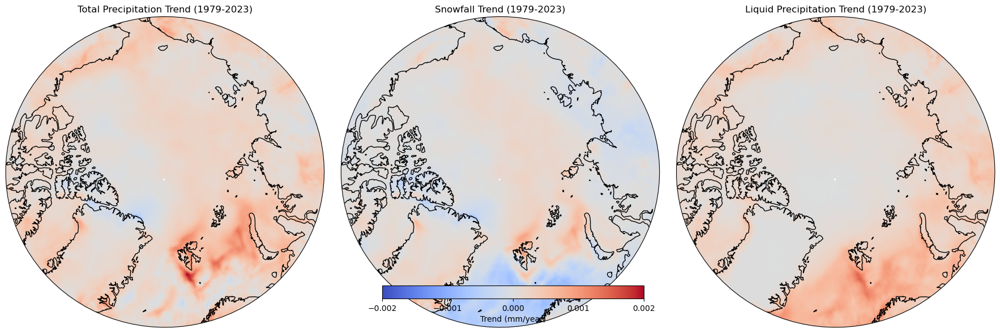

In [46]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import matplotlib.path as mpath
from scipy.stats import linregress

# Assuming `tp` (total precipitation), `sf` (snowfall), and `liquid_precip` (calculated as `tp - sf`)
# are already defined DataArrays with dimensions (time, latitude, longitude)

# Define a function to calculate the linear trend for each grid cell
def calculate_trend(data):
    """Calculate linear trend (slope) over time at each grid point."""
    time = np.arange(data.shape[0])  # Create a time array (e.g., 0, 1, 2, ...)
    slopes = np.apply_along_axis(lambda y: linregress(time, y).slope, axis=0, arr=data)
    return slopes

# Calculate trends for each variable (mm/year)
tp_trend = calculate_trend(tp) * 1000  # Convert to mm/year if needed
sf_trend = calculate_trend(sf) * 1000  # Convert to mm/year if needed
liquid_precip_trend = calculate_trend(liquid_precip) * 1000  # Convert to mm/year if needed

# Convert trends to DataArrays, assuming tp, sf, and liquid_precip have latitude and longitude coordinates
lat = tp.latitude
lon = tp.longitude
tp_trend_da = xr.DataArray(tp_trend, coords=[lat, lon], dims=["latitude", "longitude"])
sf_trend_da = xr.DataArray(sf_trend, coords=[lat, lon], dims=["latitude", "longitude"])
liquid_precip_trend_da = xr.DataArray(liquid_precip_trend, coords=[lat, lon], dims=["latitude", "longitude"])

# Set the color limits for all three maps
vmin, vmax = -0.002, 0.002

# Function to plot Arctic trends
def plot_trend(ax, data, title, vmin, vmax, cmap):
    ax.set_global()
    ax.coastlines()
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    circle = mpath.Path(np.vstack([np.cos(theta), np.sin(theta)]).T * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())  # Arctic extent
    p = ax.pcolormesh(data.longitude, data.latitude, data, transform=ccrs.PlateCarree(), cmap=cmap, vmin=vmin, vmax=vmax, shading='auto')
    ax.set_title(title)
    return p

# Set up figure and plot each variable
fig, axes = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})
cmap = 'coolwarm'

# Plot Total Precipitation Trend
tp_plot = plot_trend(axes[0], tp_trend_da, 'Total Precipitation Trend (1979-2023)', vmin, vmax, cmap)

# Plot Snowfall Trend
sf_plot = plot_trend(axes[1], sf_trend_da, 'Snowfall Trend (1979-2023)', vmin, vmax, cmap)

# Plot Liquid Precipitation Trend
liquid_precip_plot = plot_trend(axes[2], liquid_precip_trend_da, 'Liquid Precipitation Trend (1979-2023)', vmin, vmax, cmap)

# Add a single colorbar below all plots
cbar = fig.colorbar(tp_plot, ax=axes, orientation='horizontal', fraction=0.05, pad=0.1)
cbar.set_label('Trend (mm/year)')
cbar.set_ticks(np.linspace(vmin, vmax, 5))  # Optional: set specific ticks for clarity

plt.tight_layout()
plt.show()



In [47]:
import numpy as np
import xarray as xr
from scipy.stats import linregress

# Assuming `tp` (total precipitation), `sf` (snowfall), and `liquid_precip` (calculated as `tp - sf`)
# are already defined DataArrays with dimensions (time, latitude, longitude)

# Define a function to calculate the linear trend for each grid cell
def calculate_trend(data):
    """Calculate linear trend (slope) over time at each grid point."""
    time = np.arange(data.shape[0])  # Create a time array (e.g., 0, 1, 2, ...)
    slopes = np.apply_along_axis(lambda y: linregress(time, y).slope, axis=0, arr=data)
    return slopes

# Calculate trends for each variable (mm/year)
tp_trend = calculate_trend(tp) * 1000  # Convert to mm/year if needed
sf_trend = calculate_trend(sf) * 1000  # Convert to mm/year if needed
liquid_precip_trend = calculate_trend(liquid_precip) * 1000  # Convert to mm/year if needed

# Convert trends to DataArrays, assuming tp, sf, and liquid_precip have latitude and longitude coordinates
lat = tp.latitude
lon = tp.longitude
tp_trend_da = xr.DataArray(tp_trend, coords=[lat, lon], dims=["latitude", "longitude"])
sf_trend_da = xr.DataArray(sf_trend, coords=[lat, lon], dims=["latitude", "longitude"])
liquid_precip_trend_da = xr.DataArray(liquid_precip_trend, coords=[lat, lon], dims=["latitude", "longitude"])


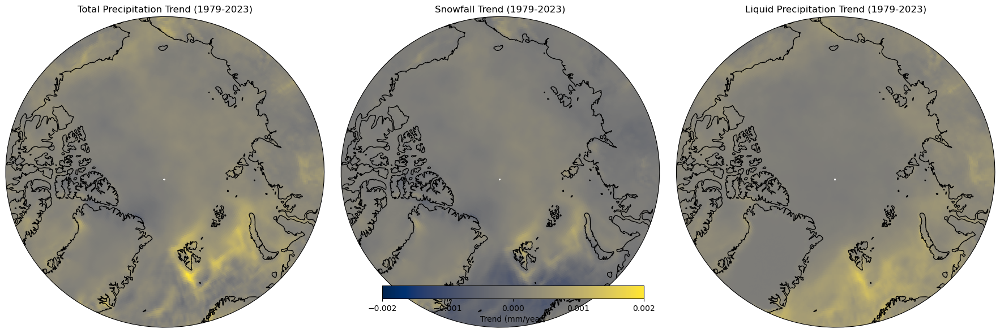

In [48]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import matplotlib.path as mpath

# Set color limits and color map
vmin, vmax = -0.002, 0.002
cmap = 'cividis'  # A perceptually uniform color map

# Function to plot Arctic trends
def plot_trend(ax, data, title, vmin, vmax, cmap):
    ax.set_global()
    ax.coastlines()
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    circle = mpath.Path(np.vstack([np.cos(theta), np.sin(theta)]).T * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())  # Arctic extent
    p = ax.pcolormesh(data.longitude, data.latitude, data, transform=ccrs.PlateCarree(), cmap=cmap, vmin=vmin, vmax=vmax, shading='auto')
    ax.set_title(title)
    return p

# Set up figure and plot each variable
fig, axes = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Plot Total Precipitation Trend
tp_plot = plot_trend(axes[0], tp_trend_da, 'Total Precipitation Trend (1979-2023)', vmin, vmax, cmap)

# Plot Snowfall Trend
sf_plot = plot_trend(axes[1], sf_trend_da, 'Snowfall Trend (1979-2023)', vmin, vmax, cmap)

# Plot Liquid Precipitation Trend
liquid_precip_plot = plot_trend(axes[2], liquid_precip_trend_da, 'Liquid Precipitation Trend (1979-2023)', vmin, vmax, cmap)

# Add a single colorbar below all plots
cbar = fig.colorbar(tp_plot, ax=axes, orientation='horizontal', fraction=0.05, pad=0.1)
cbar.set_label('Trend (mm/year)')
cbar.set_ticks(np.linspace(vmin, vmax, 5))  # Optional: set specific ticks for clarity

plt.tight_layout()
plt.show()


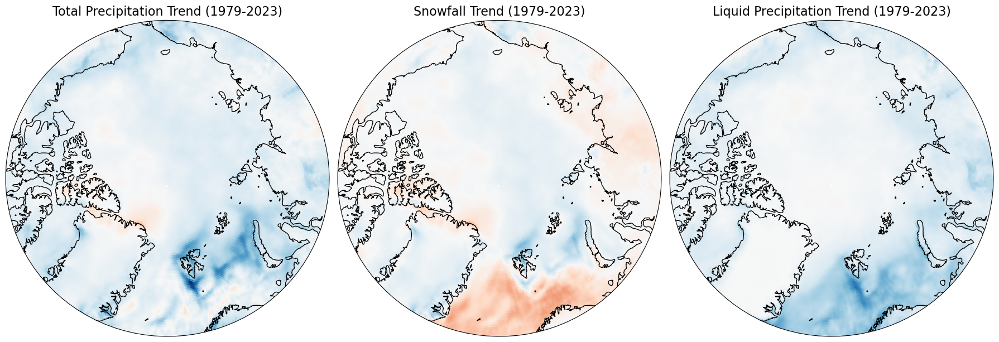

In [49]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import matplotlib.path as mpath

# Set color limits and color map
vmin, vmax = -0.002, 0.002
cmap = 'RdBu'  # Red-to-blue color map for positive and negative trends

# Function to plot Arctic trends
def plot_trend(ax, data, title, vmin, vmax, cmap):
    ax.set_global()
    ax.coastlines()
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    circle = mpath.Path(np.vstack([np.cos(theta), np.sin(theta)]).T * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())  # Arctic extent
    p = ax.pcolormesh(data.longitude, data.latitude, data, transform=ccrs.PlateCarree(), cmap=cmap, vmin=vmin, vmax=vmax, shading='auto')
    ax.set_title(title, fontsize=16)
    return p

# Set up figure and plot each variable
fig, axes = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Plot Total Precipitation Trend
tp_plot = plot_trend(axes[0], tp_trend_da, 'Total Precipitation Trend (1979-2023)', vmin, vmax, cmap)

# Plot Snowfall Trend
sf_plot = plot_trend(axes[1], sf_trend_da, 'Snowfall Trend (1979-2023)', vmin, vmax, cmap)

# Plot Liquid Precipitation Trend
liquid_precip_plot = plot_trend(axes[2], liquid_precip_trend_da, 'Liquid Precipitation Trend (1979-2023)', vmin, vmax, cmap)

# Add a single colorbar below all plots
#cbar = fig.colorbar(tp_plot, ax=axes, orientation='horizontal', fraction=0.05, pad=0.1)
#cbar.set_label('Trend (mm/year)')
#cbar.set_ticks(np.linspace(vmin, vmax, 5))  # Optional: set specific ticks for clarity

plt.tight_layout()
plt.show()


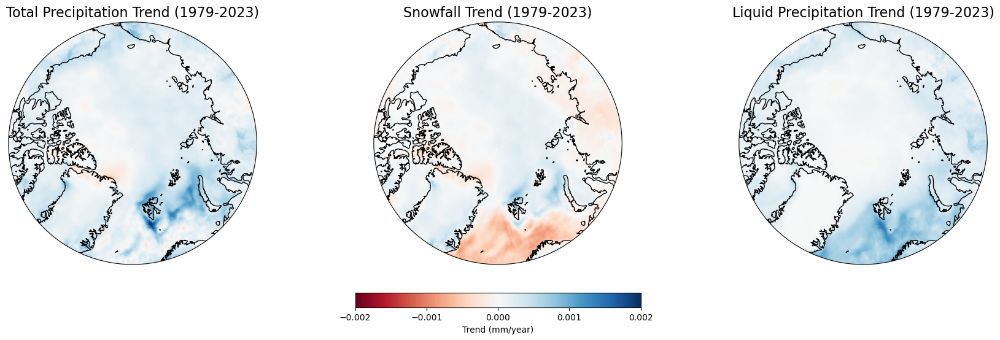

In [50]:
# Plot each trend map without the colorbar
fig, axes = plt.subplots(1, 3, figsize=(18, 6), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})
tp_plot = plot_trend(axes[0], tp_trend_da, 'Total Precipitation Trend (1979-2023)', vmin, vmax, cmap)
sf_plot = plot_trend(axes[1], sf_trend_da, 'Snowfall Trend (1979-2023)', vmin, vmax, cmap)
liquid_precip_plot = plot_trend(axes[2], liquid_precip_trend_da, 'Liquid Precipitation Trend (1979-2023)', vmin, vmax, cmap)
plt.tight_layout()

# Create a standalone color bar
fig.subplots_adjust(bottom=0.2)  # Adjust the figure to make room for the color bar
cbar = fig.colorbar(tp_plot, ax=axes, orientation='horizontal', fraction=0.05, pad=0.1)
cbar.set_label('Trend (mm/year)')
cbar.set_ticks(np.linspace(vmin, vmax, 5))  # Set specific ticks for clarity

plt.show()


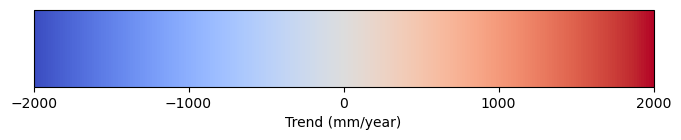

In [51]:
import matplotlib.pyplot as plt
import numpy as np

# Create a dummy mappable object for the colorbar
fig, ax = plt.subplots(figsize=(8, 1))
norm = plt.Normalize(vmin=-2000, vmax=2000)
sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=norm)
sm.set_array([])

# Add the colorbar
cbar = fig.colorbar(sm, cax=ax, orientation='horizontal')
cbar.set_label('Trend (mm/year)')
cbar.set_ticks(np.linspace(-2000, 2000, 5))  # Set ticks for the range
plt.show()


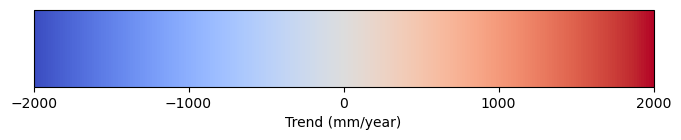

In [52]:
import matplotlib.pyplot as plt
import numpy as np

# Create a dummy mappable object for the colorbar
fig, ax = plt.subplots(figsize=(8, 1))
norm = plt.Normalize(vmin=-2000, vmax=2000)
sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=norm)
sm.set_array([])

# Add the colorbar
cbar = fig.colorbar(sm, cax=ax, orientation='horizontal')
cbar.set_label('Trend (mm/year)')
cbar.set_ticks(np.linspace(-2000, 2000, 5))  # Set ticks for the range
plt.show()


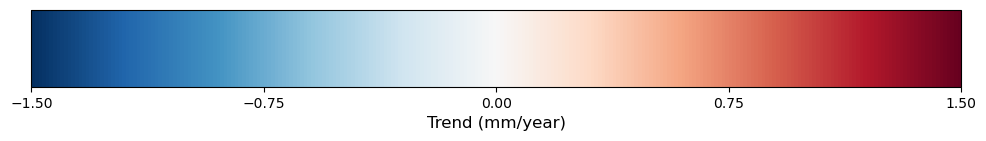

In [53]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.colorbar import ColorbarBase

# Define the range and reverse 'RdBu' colormap
vmin, vmax = -1.5, 1.5
cmap = plt.cm.get_cmap('RdBu_r')  # '_r' reverses the colormap

# Create the figure
fig, ax = plt.subplots(figsize=(12, 1))  # Stretch horizontally
norm = Normalize(vmin=vmin, vmax=vmax)
cb = ColorbarBase(ax, cmap=cmap, norm=norm, orientation='horizontal')

# Add label and ticks
cb.set_label('Trend (mm/year)', fontsize=12)
cb.set_ticks(np.linspace(vmin, vmax, 5))  # Optional: specific tick locations

plt.show()



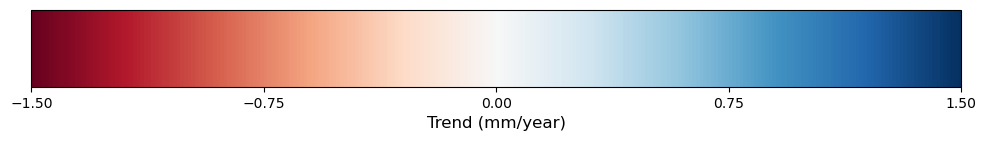

In [54]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.colorbar import ColorbarBase

# Define the range and colormap
vmin, vmax = -1.5, 1.5
cmap = plt.cm.get_cmap('RdBu')  # Normal (non-reversed) RdBu colormap

# Create the figure
fig, ax = plt.subplots(figsize=(12, 1))  # Stretch horizontally
norm = Normalize(vmin=vmin, vmax=vmax)
cb = ColorbarBase(ax, cmap=cmap, norm=norm, orientation='horizontal')

# Add label and ticks
cb.set_label('Trend (mm/year)', fontsize=12)
cb.set_ticks(np.linspace(vmin, vmax, 5))  # Optional: specific tick locations

plt.show()


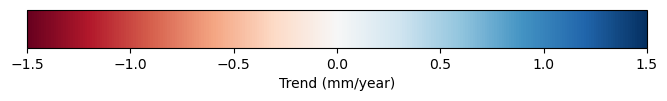

In [55]:
import matplotlib.pyplot as plt
import numpy as np

# Define the range and colormap
vmin, vmax = -1.5, 1.5
cmap = plt.cm.get_cmap('RdBu')  # RdBu colormap

# Create a figure and a colorbar
fig, ax = plt.subplots(figsize=(8, 1))
fig.subplots_adjust(bottom=0.5)

# Create a colorbar
norm = plt.Normalize(vmin=vmin, vmax=vmax)
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])  # Dummy array for ScalarMappable
cbar = fig.colorbar(sm, cax=ax, orientation="horizontal", label="Trend (mm/year)")

plt.show()



In [56]:
print(tp.dims)

('date', 'latitude', 'longitude')


In [57]:
print(tp.coords)


Coordinates:
    number     int64 ...
  * date       (date) datetime64[ns] 1979-01-01 1979-02-01 ... 2023-12-01
  * latitude   (latitude) float64 90.0 89.75 89.5 89.25 ... 60.5 60.25 60.0
  * longitude  (longitude) float64 -180.0 -179.8 -179.5 ... 179.2 179.5 179.8
    expver     (date) object ...


In [58]:
time = tp['date']


In [59]:
time = np.arange(tp.shape[0])  # Assuming `date` corresponds to the first dimension
slopes = np.apply_along_axis(lambda y: linregress(time, y).slope, axis=0, arr=tp)


In [60]:
time = (tp['date'] - np.datetime64('1979-01-01')).astype('timedelta64[D]').astype(int)


In [61]:
import numpy as np
import xarray as xr
from scipy.stats import linregress

# Function to calculate linear trend for each grid cell
def calculate_trend(data, time_coord):
    """Calculate linear trend (slope) over time at each grid point."""
    time = (time_coord - np.datetime64('1979-01-01')).astype('timedelta64[D]').astype(int)  # Convert to numeric
    slopes = np.apply_along_axis(lambda y: linregress(time, y).slope, axis=0, arr=data)
    return slopes

# Load your dataset (example)
# tp = xr.open_dataset('your_total_precipitation_file.nc')['tp']  # Total Precipitation
# sf = xr.open_dataset('your_snowfall_file.nc')['sf']            # Snowfall
# liquid_precip = tp - sf                                       # Liquid Precipitation

# Assuming `tp`, `sf`, and `liquid_precip` are already defined as DataArrays
# Use the 'date' coordinate (not 'time')
time_coord = tp['date']

# Calculate trends for each variable (convert to mm/year if needed)
tp_trend = calculate_trend(tp.values, time_coord) * 365  # Slope in mm/year
sf_trend = calculate_trend(sf.values, time_coord) * 365  # Slope in mm/year
liquid_precip_trend = calculate_trend(liquid_precip.values, time_coord) * 365  # Slope in mm/year

# Convert trends back to DataArrays
lat = tp.latitude
lon = tp.longitude
tp_trend_da = xr.DataArray(tp_trend, coords=[lat, lon], dims=["latitude", "longitude"])
sf_trend_da = xr.DataArray(sf_trend, coords=[lat, lon], dims=["latitude", "longitude"])
liquid_precip_trend_da = xr.DataArray(liquid_precip_trend, coords=[lat, lon], dims=["latitude", "longitude"])

# Print results (optional)
print(tp_trend_da)
print(sf_trend_da)
print(liquid_precip_trend_da)


<xarray.DataArray (latitude: 121, longitude: 1440)>
array([[8.94599868e-13, 8.94599868e-13, 8.94599868e-13, ...,
        8.94599868e-13, 8.94599868e-13, 8.94599868e-13],
       [1.54908633e-12, 1.55575316e-12, 1.55699050e-12, ...,
        1.54538279e-12, 1.54790419e-12, 1.54612627e-12],
       [2.42020033e-12, 2.43898821e-12, 2.43028541e-12, ...,
        2.41419886e-12, 2.43441706e-12, 2.42964019e-12],
       ...,
       [6.52507835e-12, 6.58305712e-12, 6.65370295e-12, ...,
        7.75831169e-12, 7.84421370e-12, 7.11361204e-12],
       [6.03482458e-12, 5.94110883e-12, 5.66164046e-12, ...,
        5.92127381e-12, 6.00512681e-12, 6.06547143e-12],
       [7.42893611e-12, 7.03480202e-12, 6.89814671e-12, ...,
        7.51900622e-12, 7.67930302e-12, 7.80565447e-12]])
Coordinates:
  * latitude   (latitude) float64 90.0 89.75 89.5 89.25 ... 60.5 60.25 60.0
  * longitude  (longitude) float64 -180.0 -179.8 -179.5 ... 179.2 179.5 179.8
<xarray.DataArray (latitude: 121, longitude: 1440)>
array([[

KeyError: "Ensure the time coordinate in the dataset is named 'time'. Check your dataset's coordinates."

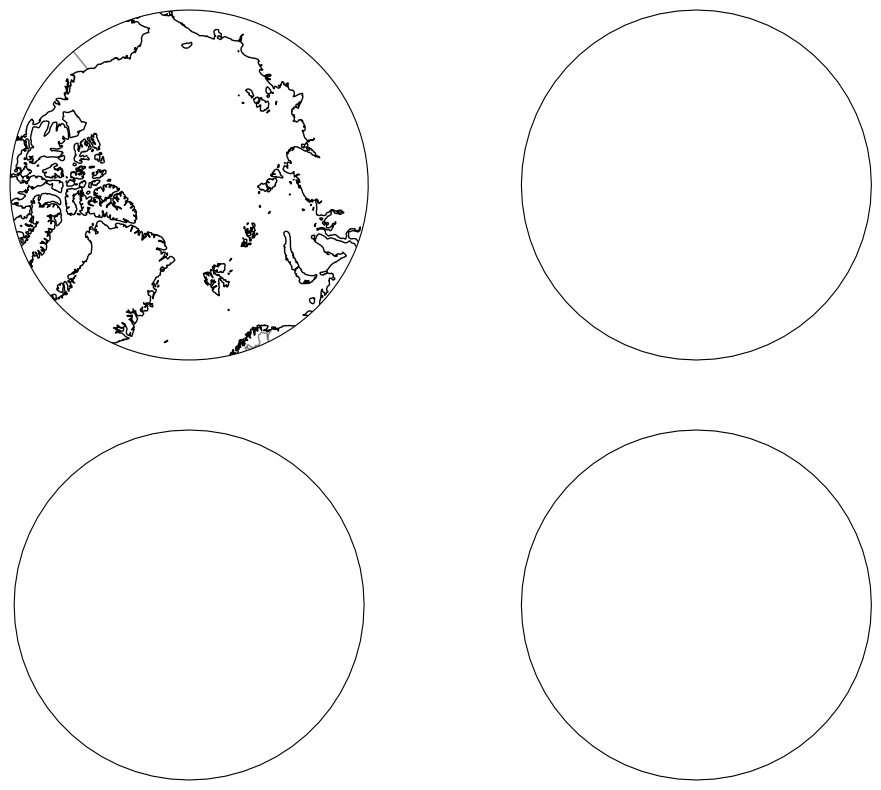

In [62]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.path as mpath

# Function to plot decadal data with contour lines
def plot_decadal_maps(data, title_prefix, cmap='Greens', vmin=0, vmax=1):
    """
    Plots decadal averages of data for the Arctic region.

    Parameters:
    - data: xarray.DataArray with dimensions (time, latitude, longitude)
    - title_prefix: string, title prefix for the plots
    - cmap: string, colormap to use
    - vmin, vmax: float, value limits for the colormap
    """
    # Define decades with their respective time slices
    decades = {
        '1979-1989': slice('1979-01-01', '1989-12-31'),
        '1990-1999': slice('1990-01-01', '1999-12-31'),
        '2000-2009': slice('2000-01-01', '2009-12-31'),
        '2010-2023': slice('2010-01-01', '2023-12-31')
    }

    # Create subplots in a 2x2 grid
    fig, axes = plt.subplots(2, 2, figsize=(12, 10), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

    for ax, (decade, time_range) in zip(axes.flat, decades.items()):
        # Add features to the map
        ax.coastlines()
        ax.add_feature(cfeature.BORDERS, linestyle='-', alpha=0.5)

        # Define a circular boundary for the polar projection
        theta = np.linspace(0, 2 * np.pi, 100)
        center, radius = [0.5, 0.5], 0.5
        verts = np.vstack([np.sin(theta), np.cos(theta)]).T
        circle = mpath.Path(verts * radius + center)
        ax.set_boundary(circle, transform=ax.transAxes)
        
        # Set extent (focus on the Arctic)
        ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

        # Select data for the specific decade and calculate the mean
        try:
            decadal_data = data.sel(time=time_range).mean(dim='time')
        except KeyError:
            raise KeyError("Ensure the time coordinate in the dataset is named 'time'. Check your dataset's coordinates.")

        # Plot the data
        pp = ax.pcolormesh(decadal_data.longitude, decadal_data.latitude, decadal_data, transform=ccrs.PlateCarree(),
                           cmap=cmap, vmin=vmin, vmax=vmax)

        # Add contour lines
        contours = ax.contour(decadal_data.longitude, decadal_data.latitude, decadal_data, transform=ccrs.PlateCarree(),
                              colors='black', linewidths=0.5, levels=np.linspace(vmin, vmax, 10))

        # Add title for each decade
        ax.set_title(decade)

    # Add a color bar below the entire figure
    cbar_ax = fig.add_axes([0.2, 0.05, 0.6, 0.02])  # Adjust the position and size (left, bottom, width, height)
    fig.colorbar(pp, cax=cbar_ax, orientation='horizontal', label='Rainfall/Total Precipitation Ratio')

    # Set the title for the whole figure
    plt.suptitle(f'{title_prefix} (1979-2023)', fontsize=16)
    plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.15)  # Adjust the layout for better spacing
    plt.show()

# Example usage (replace rainfall_ratio with your dataset)
plot_decadal_maps(rainfall_ratio, 'Decadal Changes in Rainfall/Precipitation Ratio')


In [63]:
import numpy as np
import xarray as xr
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.path as mpath

# Function to check and fix the time coordinate
def fix_time_coordinate(data):
    """Ensure the dataset has a 'time' coordinate in datetime format."""
    # Rename if 'time' is named differently
    if 'time' not in data.coords:
        time_key = [key for key in data.coords if 'time' in key.lower()]
        if time_key:
            data = data.rename({time_key[0]: 'time'})
        else:
            raise KeyError("No 'time'-like coordinate found in the dataset.")
    
    # Ensure time is in datetime format
    if not np.issubdtype(data['time'].dtype, np.datetime64):
        data['time'] = xr.DataArray(pd.to_datetime(data['time'].values), coords=data['time'].coords)
    
    return data

# Function to plot decadal data with contour lines
def plot_decadal_maps(data, title_prefix, cmap='Greens', vmin=0, vmax=1):
    """
    Plots decadal averages of data for the Arctic region.

    Parameters:
    - data: xarray.DataArray with dimensions (time, latitude, longitude)
    - title_prefix: string, title prefix for the plots
    - cmap: string, colormap to use
    - vmin, vmax: float, value limits for the colormap
    """
    # Define decades with their respective time slices
    decades = {
        '1979-1989': slice('1979-01-01', '1989-12-31'),
        '1990-1999': slice('1990-01-01', '1999-12-31'),
        '2000-2009': slice('2000-01-01', '2009-12-31'),
        '2010-2023': slice('2010-01-01', '2023-12-31')
    }

    # Create subplots in a 2x2 grid
    fig, axes = plt.subplots(2, 2, figsize=(12, 10), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

    for ax, (decade, time_range) in zip(axes.flat, decades.items()):
        # Add features to the map
        ax.coastlines()
        ax.add_feature(cfeature.BORDERS, linestyle='-', alpha=0.5)

        # Define a circular boundary for the polar projection
        theta = np.linspace(0, 2 * np.pi, 100)
        center, radius = [0.5, 0.5], 0.5
        verts = np.vstack([np.sin(theta), np.cos(theta)]).T
        circle = mpath.Path(verts * radius + center)
        ax.set_boundary(circle, transform=ax.transAxes)
        
        # Set extent (focus on the Arctic)
        ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

        # Select data for the specific decade and calculate the mean
        try:
            decadal_data = data.sel(time=time_range).mean(dim='time')
        except KeyError:
            raise KeyError("Ensure the time coordinate in the dataset is named 'time'. Check your dataset's coordinates.")

        # Plot the data
        pp = ax.pcolormesh(decadal_data.longitude, decadal_data.latitude, decadal_data, transform=ccrs.PlateCarree(),
                           cmap=cmap, vmin=vmin, vmax=vmax)

        # Add contour lines
        contours = ax.contour(decadal_data.longitude, decadal_data.latitude, decadal_data, transform=ccrs.PlateCarree(),
                              colors='black', linewidths=0.5, levels=np.linspace(vmin, vmax, 10))

        # Add title for each decade
        ax.set_title(decade)

    # Add a color bar below the entire figure
    cbar_ax = fig.add_axes([0.2, 0.05, 0.6, 0.02])  # Adjust the position and size (left, bottom, width, height)
    fig.colorbar(pp, cax=cbar_ax, orientation='horizontal', label='Rainfall/Total Precipitation Ratio')

    # Set the title for the whole figure
    plt.suptitle(f'{title_prefix} (1979-2023)', fontsize=16)
    plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.15)  # Adjust the layout for better spacing
    plt.show()

# Example usage (replace rainfall_ratio with your dataset)
# Load your dataset
# rainfall_ratio = xr.open_dataset("path_to_your_data.nc")["rainfall_ratio"]  # Replace with your variable name

# Fix the time coordinate
rainfall_ratio = fix_time_coordinate(rainfall_ratio)

# Plot decadal maps
plot_decadal_maps(rainfall_ratio, 'Decadal Changes in Rainfall/Precipitation Ratio')


KeyError: "No 'time'-like coordinate found in the dataset."

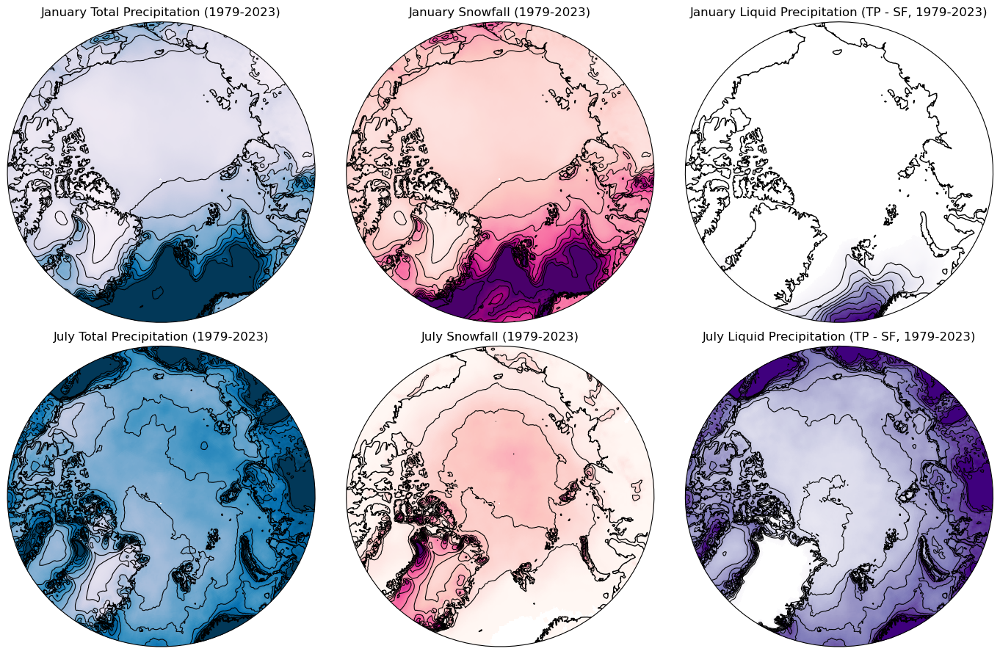

In [64]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.path as mpath
import pandas as pd

# Define the plot function with a mask and contour levels
def plot_map(ax, data, title, vmin=0, vmax=100, cmap='PuBu', contour_levels=10, mask_threshold=0):
    ax.set_global()
    ax.coastlines()
    
    # Add Arctic circular boundary
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    
    # Set Arctic extent
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Convert to mm and apply masking
    data_mm = data * 1000
    data_mm = data_mm.where(data_mm > mask_threshold)

    # Plot the data
    pp = ax.pcolormesh(data_mm.longitude, data_mm.latitude, data_mm, 
                       cmap=cmap, transform=ccrs.PlateCarree(), vmin=vmin, vmax=vmax)

    # Add contour lines without labels
    ax.contour(data_mm.longitude, data_mm.latitude, data_mm, 
               levels=np.linspace(vmin, vmax, contour_levels), colors='black', linewidths=0.8, transform=ccrs.PlateCarree())
    
    ax.set_title(title)  # Set the title for the subplot

    return pp

# Pre-calculate Liquid Precipitation
liquid_precip = tp - sf

# Convert 'date' to datetime64
tp['date'] = pd.to_datetime(tp['date'].values, format='%Y%m%d')
sf['date'] = pd.to_datetime(sf['date'].values, format='%Y%m%d')
liquid_precip['date'] = pd.to_datetime(liquid_precip['date'].values, format='%Y%m%d')

# Filter data for January and July
months_data = {
    "January": {
        "tp": tp.sel(date=tp['date'].dt.month == 1),
        "sf": sf.sel(date=sf['date'].dt.month == 1),
        "liquid": liquid_precip.sel(date=liquid_precip['date'].dt.month == 1),
    },
    "July": {
        "tp": tp.sel(date=tp['date'].dt.month == 7),
        "sf": sf.sel(date=sf['date'].dt.month == 7),
        "liquid": liquid_precip.sel(date=liquid_precip['date'].dt.month == 7),
    },
}

# Create figure and 2x3 grid for the plots
fig, axes = plt.subplots(2, 3, figsize=(14, 9), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Loop over January and July data for plotting
for i, (month, datasets) in enumerate(months_data.items()):
    # Plot total precipitation
    pp1 = plot_map(axes[i, 0], datasets["tp"].sum(dim='date'), f'{month} Total Precipitation (1979-2023)', vmin=0, vmax=100)
    # Plot snowfall
    pp2 = plot_map(axes[i, 1], datasets["sf"].sum(dim='date'), f'{month} Snowfall (1979-2023)', vmin=0, vmax=100, cmap='RdPu')
    # Plot liquid precipitation
    pp3 = plot_map(axes[i, 2], datasets["liquid"].sum(dim='date'), f'{month} Liquid Precipitation (TP - SF, 1979-2023)', 
                   vmin=0, vmax=100, cmap='Purples', mask_threshold=1)

# Adjust layout and add colorbars
plt.tight_layout()
plt.show()

# Save the figure
fig.savefig('JanuaryJulyArcticTotals.png', dpi=300, bbox_inches='tight')


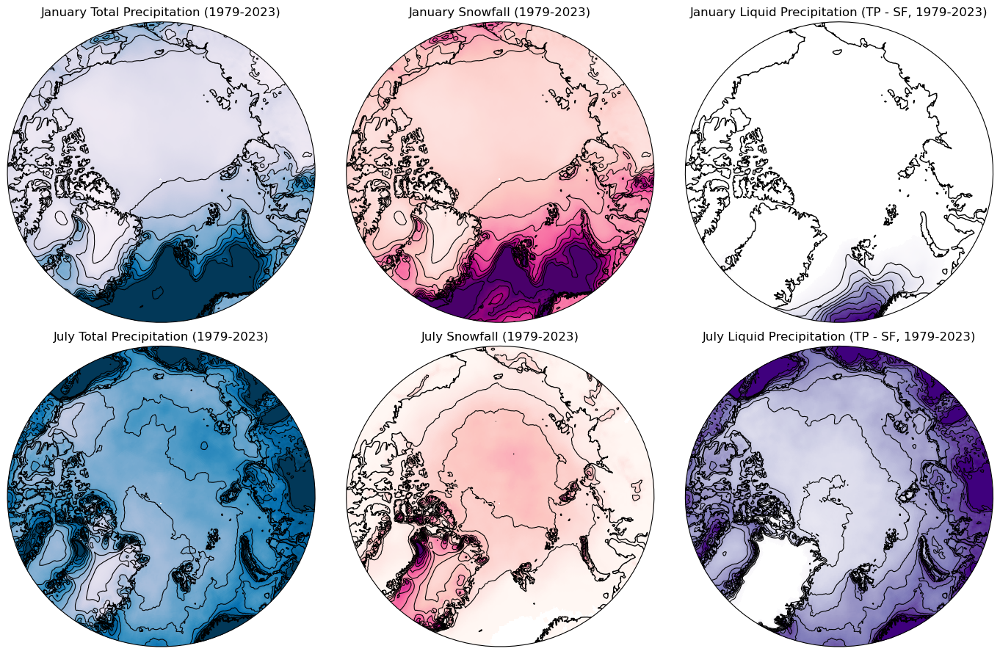

In [65]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.path as mpath
import pandas as pd

# Define the plot function with a mask and contour levels
def plot_map(ax, data, title, vmin=0, vmax=100, cmap='PuBu', contour_levels=10, mask_threshold=0):
    ax.set_global()
    ax.coastlines()
    
    # Add Arctic circular boundary
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)
    
    # Set Arctic extent
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Convert to mm and apply masking
    data_mm = data * 1000
    data_mm = data_mm.where(data_mm > mask_threshold)

    # Plot the data
    pp = ax.pcolormesh(data_mm.longitude, data_mm.latitude, data_mm, 
                       cmap=cmap, transform=ccrs.PlateCarree(), vmin=vmin, vmax=vmax)

    # Add contour lines without labels
    ax.contour(data_mm.longitude, data_mm.latitude, data_mm, 
               levels=np.linspace(vmin, vmax, contour_levels), colors='black', linewidths=0.8, transform=ccrs.PlateCarree())
    
    ax.set_title(title)  # Set the title for the subplot

    return pp

# Pre-calculate Liquid Precipitation
liquid_precip = tp - sf

# Convert 'date' to datetime64
tp['date'] = pd.to_datetime(tp['date'].values, format='%Y%m%d')
sf['date'] = pd.to_datetime(sf['date'].values, format='%Y%m%d')
liquid_precip['date'] = pd.to_datetime(liquid_precip['date'].values, format='%Y%m%d')

# Filter data for January and July
months_data = {
    "January": {
        "tp": tp.sel(date=tp['date'].dt.month == 1),
        "sf": sf.sel(date=sf['date'].dt.month == 1),
        "liquid": liquid_precip.sel(date=liquid_precip['date'].dt.month == 1),
    },
    "July": {
        "tp": tp.sel(date=tp['date'].dt.month == 7),
        "sf": sf.sel(date=sf['date'].dt.month == 7),
        "liquid": liquid_precip.sel(date=liquid_precip['date'].dt.month == 7),
    },
}

# Create figure and 2x3 grid for the plots
fig, axes = plt.subplots(2, 3, figsize=(14, 9), subplot_kw={'projection': ccrs.Orthographic(central_latitude=90)})

# Loop over January and July data for plotting
for i, (month, datasets) in enumerate(months_data.items()):
    # Plot total precipitation
    pp1 = plot_map(axes[i, 0], datasets["tp"].sum(dim='date'), f'{month} Total Precipitation (1979-2023)', vmin=0, vmax=100)
    # Plot snowfall
    pp2 = plot_map(axes[i, 1], datasets["sf"].sum(dim='date'), f'{month} Snowfall (1979-2023)', vmin=0, vmax=100, cmap='RdPu')
    # Plot liquid precipitation
    pp3 = plot_map(axes[i, 2], datasets["liquid"].sum(dim='date'), f'{month} Liquid Precipitation (TP - SF, 1979-2023)', 
                   vmin=0, vmax=100, cmap='Purples', mask_threshold=1)

# Adjust layout and add colorbars
plt.tight_layout()
plt.show()

# Save the figure
fig.savefig('JanuaryJulyArcticTotals.png', dpi=300, bbox_inches='tight')


In [66]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.path as mpath
from scipy.stats import linregress

# Define the function to calculate linear trends
def calculate_trend(data, time_dim='time'):
    """
    Calculate linear trend (slope) over the specified time dimension for each grid point.
    """
    time = np.arange(data[time_dim].size)  # Create a time array (e.g., 0, 1, 2, ...)
    slopes = np.apply_along_axis(
        lambda y: linregress(time, y).slope if np.isfinite(y).sum() > 1 else np.nan,
        axis=0,
        arr=data.values,
    )
    return xr.DataArray(slopes, coords=[data.latitude, data.longitude], dims=["latitude", "longitude"])

# Define the function to plot Arctic trends
def plot_decadal_trends(ax, trend_data, title, cmap='coolwarm', vmin=-1, vmax=1):
    """
    Plot decadal trends for Arctic regions on a polar projection.
    """
    ax.set_global()
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS, linestyle='-', alpha=0.5)

    # Circular boundary for polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)

    # Set Arctic extent
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Plot the trend data
    pp = ax.pcolormesh(
        trend_data.longitude,
        trend_data.latitude,
        trend_data,
        transform=ccrs.PlateCarree(),
        cmap=cmap,
        shading="auto",
        vmin=vmin,
        vmax=vmax,
    )
    ax.set_title(title)
    return pp

# Define decades
decades = {
    "1979-1989": slice("1979-01-01", "1989-12-31"),
    "1990-1999": slice("1990-01-01", "1999-12-31"),
    "2000-2009": slice("2000-01-01", "2009-12-31"),
    "2010-2023": slice("2010-01-01", "2023-12-31"),
}

# Calculate trends for each decade
tp_trends = {}
sf_trends = {}
for decade, time_range in decades.items():
    tp_decade = tp.sel(time=time_range)
    sf_decade = sf.sel(time=time_range)
    tp_trends[decade] = calculate_trend(tp_decade, time_dim="time")
    sf_trends[decade] = calculate_trend(sf_decade, time_dim="time")

# Plot trends for total precipitation and snowfall
fig, axes = plt.subplots(4, 2, figsize=(14, 16), subplot_kw={"projection": ccrs.Orthographic(central_latitude=90)})
cmap = "coolwarm"
vmin, vmax = -1, 1  # Adjust based on expected trend range (mm/year)

for i, (decade, tp_trend) in enumerate(tp_trends.items()):
    # Plot total precipitation trend
    pp = plot_decadal_trends(
        axes[i, 0], tp_trend, f"Total Precipitation Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )

    # Plot snowfall trend
    plot_decadal_trends(
        axes[i, 1], sf_trends[decade], f"Snowfall Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )

# Add a colorbar for the entire figure
fig.colorbar(pp, ax=axes[:, 0], orientation="horizontal", fraction=0.05, pad=0.1, label="Trend (mm/year)")
plt.tight_layout()
plt.show()

# Save the figure
fig.savefig("DecadalTrends_TP_SF.png", dpi=300, bbox_inches="tight")


KeyError: "'time' is not a valid dimension or coordinate"

In [67]:
# Check and rename the time coordinate if necessary
if 'time' not in tp.coords:
    time_key = [key for key in tp.coords if 'time' in key.lower()]
    if time_key:
        tp = tp.rename({time_key[0]: 'time'})
        sf = sf.rename({time_key[0]: 'time'})
    else:
        raise KeyError("'time' is not found. Check the dataset's coordinates.")

# Ensure the time is in datetime format
tp['time'] = pd.to_datetime(tp['time'])
sf['time'] = pd.to_datetime(sf['time'])

# Now calculate trends as before
tp_trends = {}
sf_trends = {}
for decade, time_range in decades.items():
    tp_decade = tp.sel(time=time_range)
    sf_decade = sf.sel(time=time_range)
    tp_trends[decade] = calculate_trend(tp_decade, time_dim="time")
    sf_trends[decade] = calculate_trend(sf_decade, time_dim="time")


KeyError: "'time' is not found. Check the dataset's coordinates."

In [68]:
print(tp)


<xarray.DataArray 'tp' (date: 540, latitude: 121, longitude: 1440)>
array([[[0.000294, 0.000294, ..., 0.000294, 0.000294],
        [0.000278, 0.000278, ..., 0.000278, 0.000278],
        ...,
        [0.003147, 0.003361, ..., 0.002781, 0.002934],
        [0.003075, 0.00329 , ..., 0.002762, 0.002861]],

       [[0.00016 , 0.00016 , ..., 0.00016 , 0.00016 ],
        [0.000143, 0.000143, ..., 0.000143, 0.000143],
        ...,
        [0.002077, 0.002045, ..., 0.00214 , 0.002119],
        [0.00206 , 0.002058, ..., 0.002087, 0.00206 ]],

       ...,

       [[0.000519, 0.000519, ..., 0.000519, 0.000519],
        [0.000502, 0.000502, ..., 0.000504, 0.000502],
        ...,
        [0.003819, 0.003834, ..., 0.003889, 0.003801],
        [0.004042, 0.004051, ..., 0.004082, 0.00403 ]],

       [[0.000353, 0.000353, ..., 0.000353, 0.000353],
        [0.000349, 0.000349, ..., 0.000349, 0.000349],
        ...,
        [0.004807, 0.004841, ..., 0.004814, 0.00478 ],
        [0.004347, 0.004404, ..., 0.

In [69]:
tp = tp.rename({'date': 'time'})
sf = sf.rename({'date': 'time'})


In [70]:
tp_decade = tp.sel(time=time_range)

In [71]:
tp_decade = tp.sel(date=time_range)

KeyError: "'date' is not a valid dimension or coordinate"

In [72]:
# Adjust to use 'date' instead of 'time'
tp_trends = {}
sf_trends = {}
for decade, time_range in decades.items():
    tp_decade = tp.sel(date=time_range)
    sf_decade = sf.sel(date=time_range)
    tp_trends[decade] = calculate_trend(tp_decade, time_dim="date")
    sf_trends[decade] = calculate_trend(sf_decade, time_dim="date")


KeyError: "'date' is not a valid dimension or coordinate"

In [73]:
print(tp.dims)
print(tp.coords)


('time', 'latitude', 'longitude')
Coordinates:
    number     int64 ...
  * time       (time) datetime64[ns] 1979-01-01 1979-02-01 ... 2023-12-01
  * latitude   (latitude) float64 90.0 89.75 89.5 89.25 ... 60.5 60.25 60.0
  * longitude  (longitude) float64 -180.0 -179.8 -179.5 ... 179.2 179.5 179.8
    expver     (time) object ...


In [74]:
tp = tp.assign_coords(number=("number", tp["date"].values))
tp = tp.rename({"number": "time"})


KeyError: 'date'

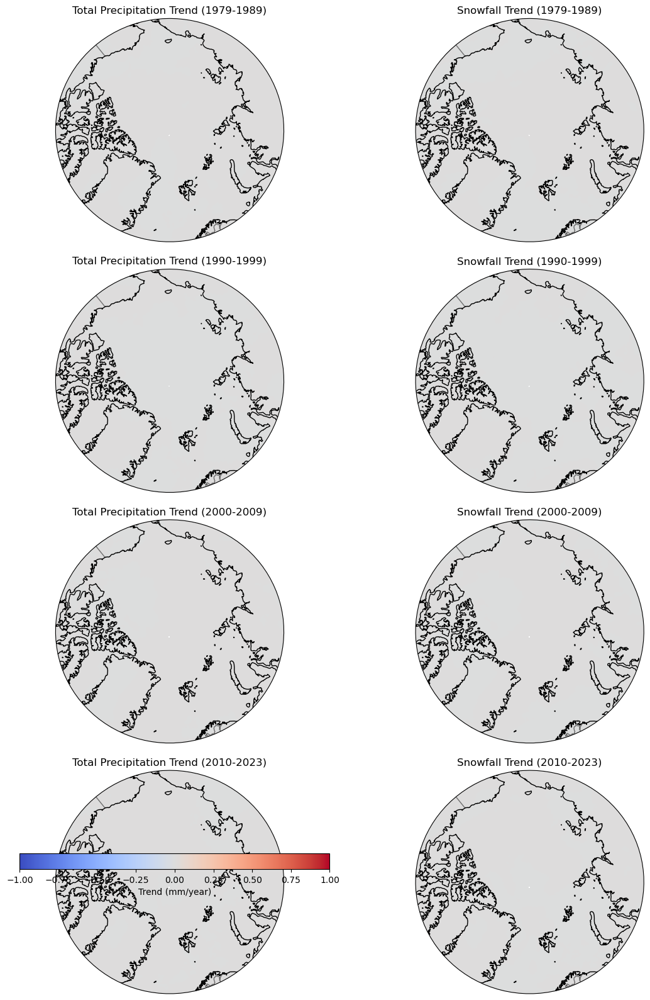

In [75]:
# Define decades using the existing 'time' dimension
decades = {
    "1979-1989": slice("1979-01-01", "1989-12-31"),
    "1990-1999": slice("1990-01-01", "1999-12-31"),
    "2000-2009": slice("2000-01-01", "2009-12-31"),
    "2010-2023": slice("2010-01-01", "2023-12-31"),
}

# Function to calculate linear trends
def calculate_trend(data, time_dim='time'):
    """
    Calculate linear trend (slope) over the specified time dimension for each grid point.
    """
    time = np.arange(data[time_dim].size)  # Create a time array (e.g., 0, 1, 2, ...)
    slopes = np.apply_along_axis(
        lambda y: linregress(time, y).slope if np.isfinite(y).sum() > 1 else np.nan,
        axis=0,
        arr=data.values,
    )
    return xr.DataArray(slopes, coords=[data.latitude, data.longitude], dims=["latitude", "longitude"])

# Calculate trends for total precipitation (tp) and snowfall (sf)
tp_trends = {}
sf_trends = {}
for decade, time_range in decades.items():
    tp_decade = tp.sel(time=time_range)  # Use 'time' for slicing
    sf_decade = sf.sel(time=time_range)  # Use 'time' for slicing
    tp_trends[decade] = calculate_trend(tp_decade, time_dim="time")
    sf_trends[decade] = calculate_trend(sf_decade, time_dim="time")

# Plot trends for each decade
fig, axes = plt.subplots(4, 2, figsize=(14, 16), subplot_kw={"projection": ccrs.Orthographic(central_latitude=90)})
cmap = "coolwarm"
vmin, vmax = -1, 1  # Adjust based on expected trend range (mm/year)

for i, (decade, tp_trend) in enumerate(tp_trends.items()):
    # Plot total precipitation trend
    pp = plot_decadal_trends(
        axes[i, 0], tp_trend, f"Total Precipitation Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )

    # Plot snowfall trend
    plot_decadal_trends(
        axes[i, 1], sf_trends[decade], f"Snowfall Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )

# Add a colorbar for the entire figure
fig.colorbar(pp, ax=axes[:, 0], orientation="horizontal", fraction=0.05, pad=0.1, label="Trend (mm/year)")
plt.tight_layout()
plt.show()

# Save the figure
fig.savefig("DecadalTrends_TP_SF.png", dpi=300, bbox_inches="tight")


In [76]:
print(tp)
print(tp.values)
print(sf)
print(sf.values)


<xarray.DataArray 'tp' (time: 540, latitude: 121, longitude: 1440)>
array([[[0.000294, 0.000294, ..., 0.000294, 0.000294],
        [0.000278, 0.000278, ..., 0.000278, 0.000278],
        ...,
        [0.003147, 0.003361, ..., 0.002781, 0.002934],
        [0.003075, 0.00329 , ..., 0.002762, 0.002861]],

       [[0.00016 , 0.00016 , ..., 0.00016 , 0.00016 ],
        [0.000143, 0.000143, ..., 0.000143, 0.000143],
        ...,
        [0.002077, 0.002045, ..., 0.00214 , 0.002119],
        [0.00206 , 0.002058, ..., 0.002087, 0.00206 ]],

       ...,

       [[0.000519, 0.000519, ..., 0.000519, 0.000519],
        [0.000502, 0.000502, ..., 0.000504, 0.000502],
        ...,
        [0.003819, 0.003834, ..., 0.003889, 0.003801],
        [0.004042, 0.004051, ..., 0.004082, 0.00403 ]],

       [[0.000353, 0.000353, ..., 0.000353, 0.000353],
        [0.000349, 0.000349, ..., 0.000349, 0.000349],
        ...,
        [0.004807, 0.004841, ..., 0.004814, 0.00478 ],
        [0.004347, 0.004404, ..., 0.

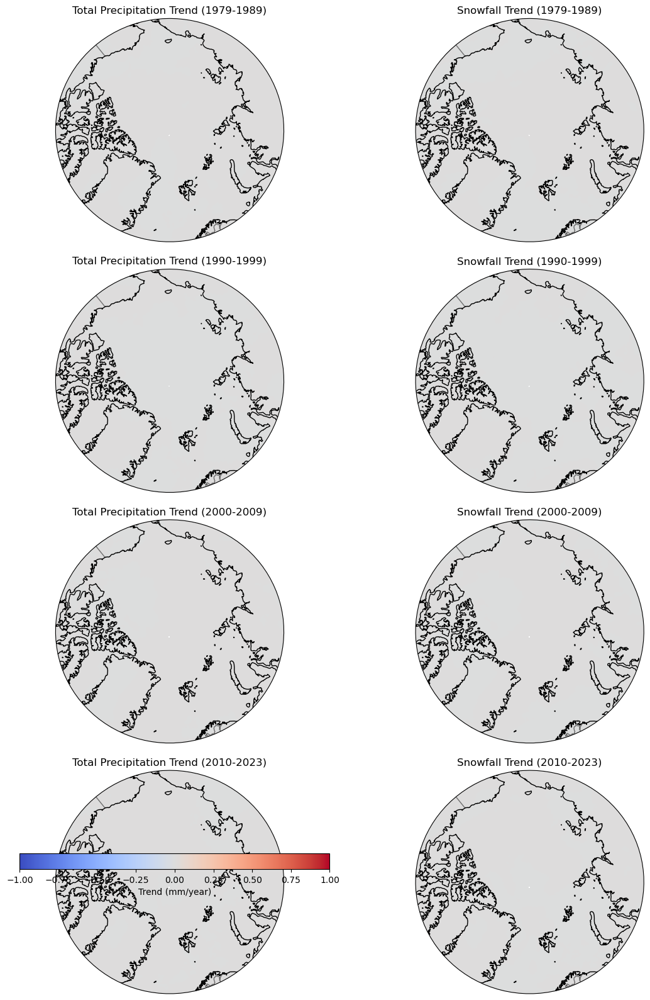

In [77]:
# Plot trends for total precipitation and snowfall
fig, axes = plt.subplots(4, 2, figsize=(14, 16), subplot_kw={"projection": ccrs.Orthographic(central_latitude=90)})
cmap = "coolwarm"
vmin, vmax = -1, 1  # Set the range to -1 to 1 for consistent visualization

for i, (decade, tp_trend) in enumerate(tp_trends.items()):
    # Plot total precipitation trend
    pp = plot_decadal_trends(
        axes[i, 0], tp_trend, f"Total Precipitation Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )

    # Plot snowfall trend
    plot_decadal_trends(
        axes[i, 1], sf_trends[decade], f"Snowfall Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )

# Add a colorbar for the entire figure
fig.colorbar(pp, ax=axes[:, 0], orientation="horizontal", fraction=0.05, pad=0.1, label="Trend (mm/year)")
plt.tight_layout()
plt.show()

# Save the figure
fig.savefig("DecadalTrends_TP_SF.png", dpi=300, bbox_inches="tight")



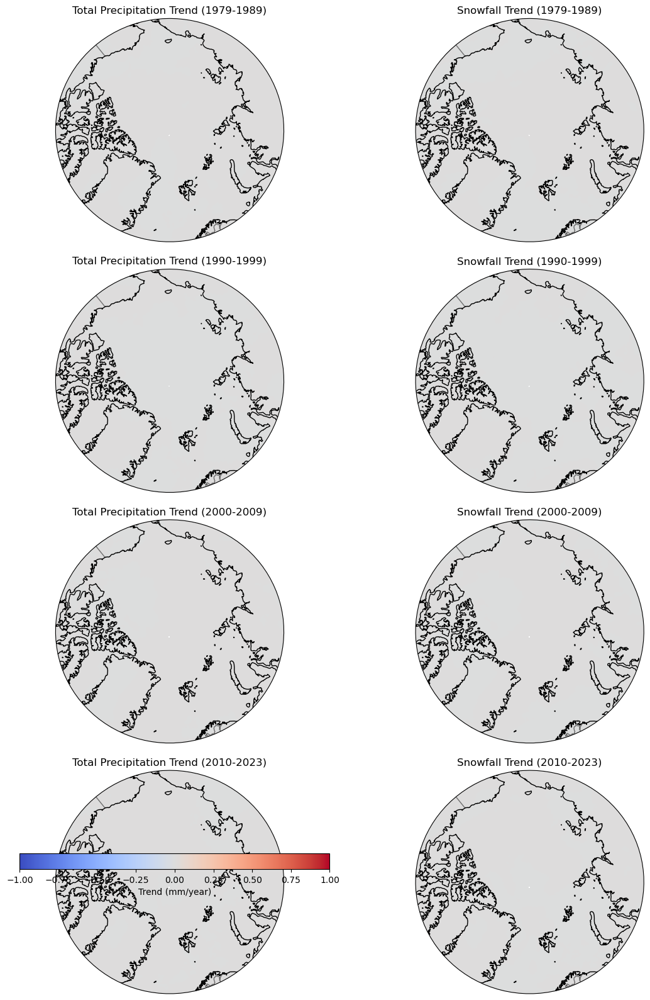

In [78]:
# Convert to millimeters if data is in meters
tp_mm = tp * 1000  # Total precipitation in mm
sf_mm = sf * 1000  # Snowfall in mm

# Define the range for trends
vmin, vmax = -1, 1  # Adjust based on the trend range

# Plot trends
fig, axes = plt.subplots(4, 2, figsize=(14, 16), subplot_kw={"projection": ccrs.Orthographic(central_latitude=90)})
cmap = "coolwarm"

for i, (decade, tp_trend) in enumerate(tp_trends.items()):
    # Plot total precipitation trend
    pp = plot_decadal_trends(
        axes[i, 0], tp_trend, f"Total Precipitation Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )

    # Plot snowfall trend
    plot_decadal_trends(
        axes[i, 1], sf_trends[decade], f"Snowfall Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )

# Add a colorbar
fig.colorbar(pp, ax=axes[:, 0], orientation="horizontal", fraction=0.05, pad=0.1, label="Trend (mm/year)")
plt.tight_layout()
plt.show()


AttributeError: 'dict' object has no attribute 'longitude'

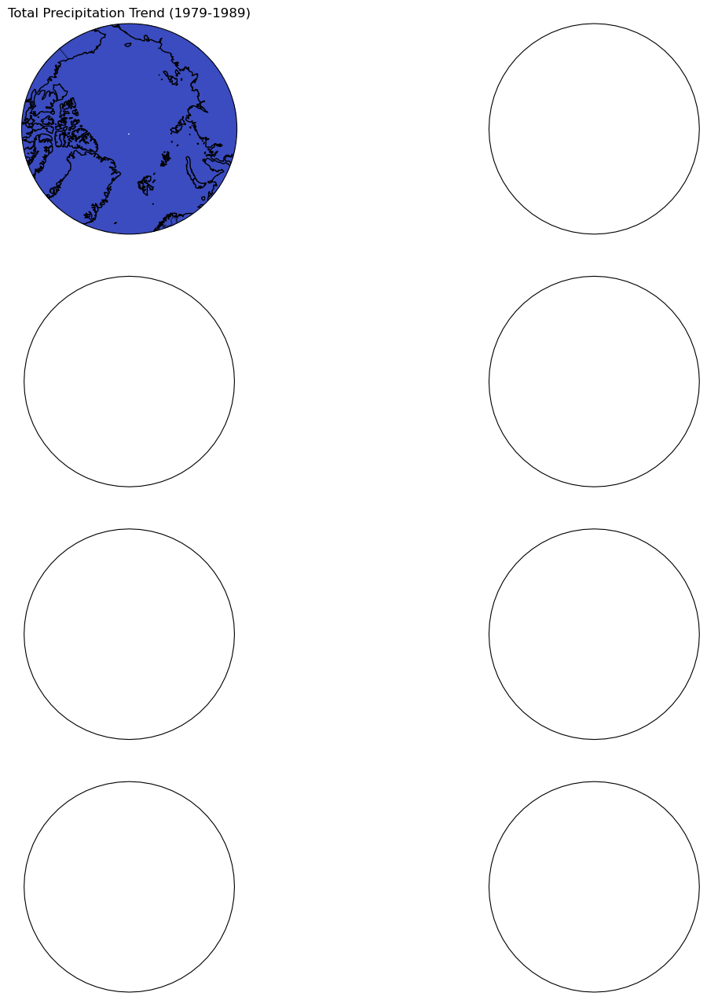

In [79]:
# Define the range for trends
vmin, vmax = 0.0001, 0.005  # Set the range to 0.0001 to 0.005

# Plot trends
fig, axes = plt.subplots(4, 2, figsize=(14, 16), subplot_kw={"projection": ccrs.Orthographic(central_latitude=90)})
cmap = "coolwarm"  # Colormap for positive/negative trends

for i, (decade, tp_trend) in enumerate(tp_trends.items()):
    # Plot total precipitation trend
    pp = plot_decadal_trends(
        axes[i, 0], tp_trend, f"Total Precipitation Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )
 # Add contour lines
    contours = ax.contour(data.longitude, data.latitude, data, transform=ccrs.PlateCarree(), colors='black', linewidths=0.8, levels=np.linspace(vmin, vmax, 10))
    
    # Plot snowfall trend
    plot_decadal_trends(
        axes[i, 1], sf_trends[decade], f"Snowfall Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )

# Add a colorbar for the entire figure
fig.colorbar(pp, ax=axes[:, 0], orientation="horizontal", fraction=0.05, pad=0.1, label="Trend (m/year)")
plt.tight_layout()
plt.show()


Trend Range: vmin=-1.744769018419469e-05, vmax=1.744769018419469e-05


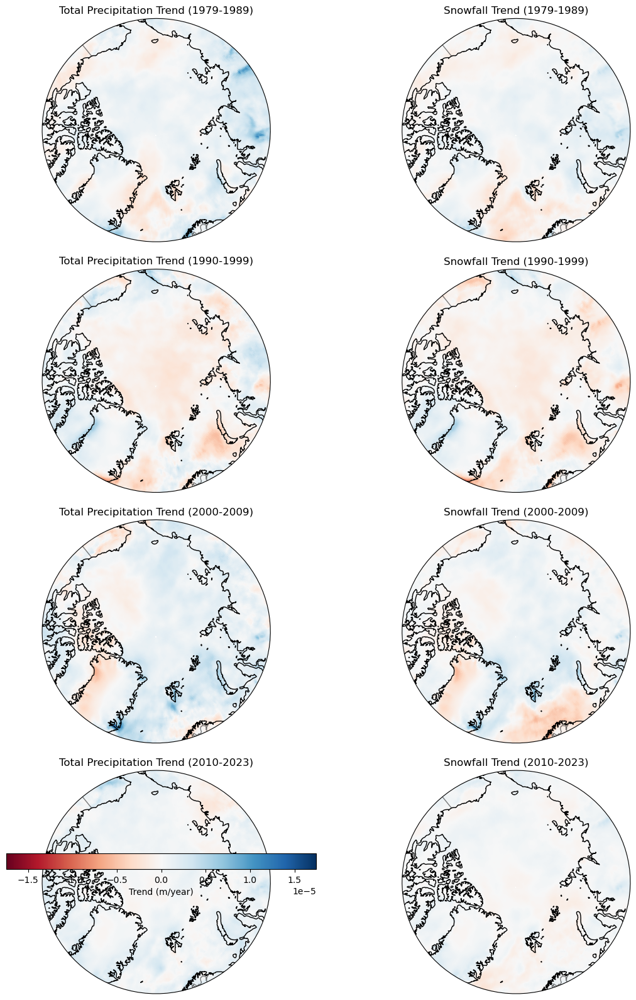

In [81]:
# Dynamically calculate vmin and vmax
trend_min = float(tp_trends["2000-2009"].min())
trend_max = float(tp_trends["2000-2009"].max())

# Adjust range based on observed trends
vmin = min(trend_min, -trend_max)  # Symmetric range for positive/negative trends
vmax = max(trend_max, -trend_min)
vmin, vmax = vmin * 1.1, vmax * 1.1  # Add a 10% buffer for visualization

print(f"Trend Range: vmin={vmin}, vmax={vmax}")

# Plot with adjusted range
fig, axes = plt.subplots(4, 2, figsize=(14, 16), subplot_kw={"projection": ccrs.Orthographic(central_latitude=90)})
cmap = "RdBu"

for i, (decade, tp_trend) in enumerate(tp_trends.items()):
    # Plot total precipitation trend
    pp = plot_decadal_trends(
        axes[i, 0], tp_trend, f"Total Precipitation Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )

    # Plot snowfall trend
    plot_decadal_trends(
        axes[i, 1], sf_trends[decade], f"Snowfall Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )

# Add a colorbar for the entire figure
fig.colorbar(pp, ax=axes[:, 0], orientation="horizontal", fraction=0.05, pad=0.1, label="Trend (m/year)")
plt.tight_layout()
plt.show()


Trend Range: vmin=-1.744769018419469e-05, vmax=1.744769018419469e-05


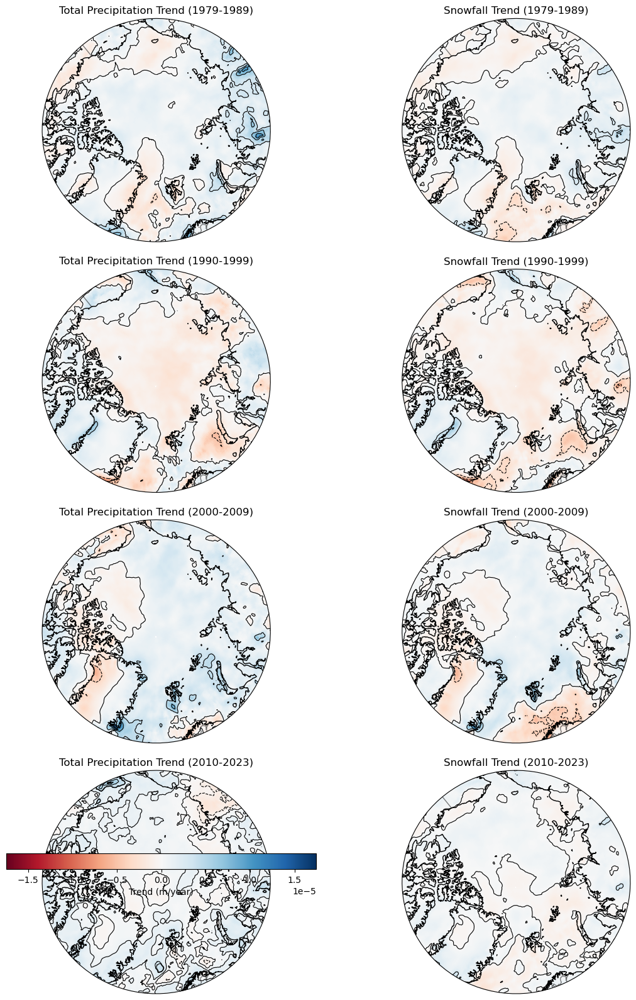

In [87]:
# Dynamically calculate vmin and vmax
trend_min = float(tp_trends["2000-2009"].min())
trend_max = float(tp_trends["2000-2009"].max())

# Adjust range based on observed trends
vmin = min(trend_min, -trend_max)  # Symmetric range for positive/negative trends
vmax = max(trend_max, -trend_min)
vmin *= 1.1  # Add a 10% buffer for visualization
vmax *= 1.1

print(f"Trend Range: vmin={vmin}, vmax={vmax}")

# Plot with adjusted range
fig, axes = plt.subplots(4, 2, figsize=(14, 16), subplot_kw={"projection": ccrs.Orthographic(central_latitude=90)})
cmap = "RdBu"

for i, (decade, tp_trend) in enumerate(tp_trends.items()):
    # Plot total precipitation trend
    plot_decadal_trends(
        axes[i, 0], tp_trend, f"Total Precipitation Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )
    # Add filled contour lines for total precipitation
    axes[i, 0].contour(
        tp_trend.coords["longitude"],  # Adjust key to match your dataset
        tp_trend.coords["latitude"],  # Adjust key to match your dataset
        tp_trend.values,              # Extract data values
        transform=ccrs.PlateCarree(),
        colors="black",
        linewidths=0.8  # Adjust thickness to match the style
    )
    
    # Plot snowfall trend
    plot_decadal_trends(
        axes[i, 1], sf_trends[decade], f"Snowfall Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )
    # Add filled contour lines for snowfall
    axes[i, 1].contour(
        sf_trends[decade].coords["longitude"],  # Adjust key to match your dataset
        sf_trends[decade].coords["latitude"],  # Adjust key to match your dataset
        sf_trends[decade].values,              # Extract data values
        transform=ccrs.PlateCarree(),
        colors="black",
        linewidths=0.8
    )
levels = np.linspace(vmin, vmax, 20)  # 20 evenly spaced levels
axes[i, 0].contour(
    tp_trend.coords["longitude"], 
    tp_trend.coords["latitude"], 
    tp_trend.values, 
    levels=levels,
    transform=ccrs.PlateCarree(),
    colors="black",
    linewidths=0.8
)

# Add a colorbar for the entire figure
fig.colorbar(pp, ax=axes[:, 0], orientation="horizontal", fraction=0.05, pad=0.1, label="Trend (m/year)")
plt.tight_layout()
plt.show()



In [ ]:
# Dynamically calculate vmin and vmax based on data range
trend_min = float(tp_trends["2000-2009"].min())
trend_max = float(tp_trends["2000-2009"].max())

# Adjust range for better visualization
vmin = min(trend_min, -trend_max) * 1  # Symmetric range with a buffer for trends
vmax = max(trend_max, -trend_min) * 1
print(f"Adjusted Trend Range: vmin={vmin}, vmax={vmax}")

# Define a diverging colormap with enhanced contrast
cmap = plt.cm.get_cmap("RdBu", 20)  # 20 levels for smoother gradients

# Plot with enhanced visualization
fig, axes = plt.subplots(4, 2, figsize=(14, 16), subplot_kw={"projection": ccrs.Orthographic(central_latitude=90)})

for i, (decade, tp_trend) in enumerate(tp_trends.items()):
    # Plot total precipitation trend
    plot_decadal_trends(
        axes[i, 0], tp_trend, f"Total Precipitation Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )

    # Plot snowfall trend
    plot_decadal_trends(
        axes[i, 1], sf_trends[decade], f"Snowfall Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )

# Add layout adjustments
plt.tight_layout()
plt.show()

# Optionally save the figure
fig.savefig("DecadalTrends_Enhanced.png", dpi=300, bbox_inches="tight")


In [ ]:
  import matplotlib.pyplot as plt
import numpy as np

# Define the range and colormap
vmin, vmax = -1.5, 1.5  # Range for the color bar
cmap = plt.cm.get_cmap("RdBu")  # Colormap with 20 levels for smoother gradients

# Create a figure for the color bar
fig, ax = plt.subplots(figsize=(8, 1))  # Adjust the figure size for the color bar
fig.subplots_adjust(bottom=0.5)

# Create a colorbar
norm = plt.Normalize(vmin=vmin, vmax=vmax)  # Normalize to the range
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])  # Dummy array for ScalarMappable
cbar = fig.colorbar(sm, cax=ax, orientation="horizontal", label="Trend (mm/year)")

# Display the color bar
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Define the range and colormap
vmin, vmax = -1.5, 1.5  # Range for the color bar
cmap = plt.cm.get_cmap("RdBu_r")  # Regular RdBu colormap for blue-to-red gradient

# Create a figure for the color bar
fig, ax = plt.subplots(figsize=(8, 1))  # Adjust the figure size for the color bar
fig.subplots_adjust(bottom=0.5)

# Create a colorbar
norm = plt.Normalize(vmin=vmin, vmax=vmax)  # Normalize to the range
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])  # Dummy array for ScalarMappable
cbar = fig.colorbar(sm, cax=ax, orientation="horizontal", label="Trend (mm/year)")

# Customize ticks for better readability
cbar.set_ticks(np.linspace(vmin, vmax, 7))  # Adjust the number of ticks if needed

# Display the color bar
plt.show()


In [1]:
def plot_decadal_trends(ax, trend_data, title, cmap="RdBu", vmin=-1, vmax=1):
    """
    Plot Arctic trends with contour lines (no labels) for enhanced visualization.
    """
    ax.set_global()
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS, linestyle="-", alpha=0.5)

    # Define a circular boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)

    # Set Arctic extent
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Plot the data
    p = ax.pcolormesh(
        trend_data.longitude,
        trend_data.latitude,
        trend_data,
        transform=ccrs.PlateCarree(),
        cmap=cmap,
        vmin=vmin,
        vmax=vmax,
        shading="auto",
    )

    # Add contour lines without labels
    ax.contour(
        trend_data.longitude,
        trend_data.latitude,
        trend_data,
        levels=np.linspace(vmin, vmax, 10),  # Adjust the number of contour levels
        colors="black",
        linewidths=0.5,
        transform=ccrs.PlateCarree(),
    )

    # Set the title
    ax.set_title(title)

    return p


In [2]:
def plot_decadal_trends(ax, trend_data, title, cmap="RdBu", vmin=-1, vmax=1):
    """
    Plot Arctic trends with enhanced contour lines for visualization.
    """
    ax.set_global()
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS, linestyle="-", alpha=0.5)

    # Define a circular boundary for the polar projection
    theta = np.linspace(0, 2 * np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    ax.set_boundary(circle, transform=ax.transAxes)

    # Set Arctic extent
    ax.set_extent([-180, 180, 66.5, 90], crs=ccrs.PlateCarree())

    # Plot the data
    p = ax.pcolormesh(
        trend_data.longitude,
        trend_data.latitude,
        trend_data,
        transform=ccrs.PlateCarree(),
        cmap=cmap,
        vmin=vmin,
        vmax=vmax,
        shading="auto",
    )

    # Add enhanced contour lines
    ax.contour(
        trend_data.longitude,
        trend_data.latitude,
        trend_data,
        levels=np.linspace(vmin, vmax, 15),  # Increase the number of contour levels
        colors="black",  # Make contours black for high contrast
        linewidths=0.8,  # Use slightly thicker lines
        linestyles="solid",  # Solid lines for clarity
        transform=ccrs.PlateCarree(),
    )

    # Set the title
    ax.set_title(title, fontsize=12)

    return p


In [3]:
# Dynamically calculate vmin and vmax
trend_min = float(tp_trends["2000-2009"].min())
trend_max = float(tp_trends["2000-2009"].max())

# Adjust range based on observed trends
vmin = min(trend_min, -trend_max)  # Symmetric range for positive/negative trends
vmax = max(trend_max, -trend_min)
vmin, vmax = vmin * 1.1, vmax * 1.1  # Add a 10% buffer for visualization

print(f"Trend Range: vmin={vmin}, vmax={vmax}")

# Plot with enhanced contours
fig, axes = plt.subplots(4, 2, figsize=(14, 16), subplot_kw={"projection": ccrs.Orthographic(central_latitude=90)})
cmap = "RdBu"

for i, (decade, tp_trend) in enumerate(tp_trends.items()):
    # Plot total precipitation trend
    pp = plot_decadal_trends(
        axes[i, 0], tp_trend, f"Total Precipitation Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )

    # Plot snowfall trend
    plot_decadal_trends(
        axes[i, 1], sf_trends[decade], f"Snowfall Trend ({decade})", cmap=cmap, vmin=vmin, vmax=vmax
    )

# Add a colorbar for the entire figure
fig.colorbar(pp, ax=axes[:, 0], orientation="horizontal", fraction=0.05, pad=0.1, label="Trend (m/year)")
plt.tight_layout()
plt.show()


NameError: name 'tp_trends' is not defined